<a href="https://colab.research.google.com/github/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/blob/blix/Ensemble_end_to_end_implementation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Physics-Guided AI for Enhanced Heat Index Forecasting in the Philippine Context (Ensemble)


# Import Python Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [96]:
import cudf
import cupy as cp

In [2]:
import torch

if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)} is available.")
else:
    print("No GPU available. Training will run on CPU.")

GPU: Tesla T4 is available.


In [3]:
!nvidia-smi

Thu Sep 25 02:09:23 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   56C    P8             12W /   70W |       2MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## Data Loading

Climatological data from DOST-PAGASA (http://bagong.pagasa.dost.gov.ph/climate/climate-data)
Notes:
- 999.0 indicate Missing Values
- TMAX (Maximum Temperature, Unit: Deg C)
- TMIN (Minimum Temperature, Unit: Deg C)
- RH (Relative Humidity, Unit: %)
- Wind Speed, Unit: m/s
- Wind direction, Unit: degree relative to North indicating where the wind is blowing from

Stations:
- NAIA Latitude: 14.5047 N Longitude: 121.004751 E Elevation: 21 m
- Port Area Latitude: 14.58841 N Longitude: 120.967866 E Elevation: 15 m
- Science Garden Latitude: 14.645072 N Longitude: 121.044282 E Elevation: 42 m
- Baguio Latitude: 16.403992 N Longitude: 120.60147 E Elevation: 1510.08 m
- Laoag Latitude: 18.183016 N Longitude: 120.534723 E Elevation: 5 m
- Sinait Latitude: 17.89019 N Longitude: 120.459762 E Elevation: 58.129 m
- Dagupan Latitude: 16.086784 N Longitude: 120.352045 E Elevation: 2 m
- Tuguegarao Latitude: 17.647678 N Longitude: 121.758469 E Elevation: 62 m
- Aparri Latitude: 18.360059 N Longitude: 121.630454 E Elevation: 3 m
- Basco Radar Latitude: 20.427284 N Longitude: 121.970536 E Elevation: 167 m
- Baler Radar Latitude: 15.748809 N Longitude: 121.632028 E Elevation: 173 m
- Cabanatuan Latitude: 15.470387 N Longitude: 120.951143 E Elevation: 32 m
- CLSU Latitude: 15.73586 N Longitude: 120.9368 E Elevation: 7.6 m
- Clark Latitude: 15.1717 N Longitude: 120.5616667 E Elevation: 151.564 m
- Iba Latitude: 15.328408 N Longitude: 119.965661 E Elevation: 5.538 m
- Ambulong Latitude: 14.09008056 N Longitude: 121.0552444 E Elevation: 11 m
- Sangley Point Latitude: 14.494953 N Longitude: 120.906838 E Elevation: 3 m
- Tanay Latitude: 14.581167 N Longitude: 121.36927 E Elevation: 650 m
- Infanta Latitude: 14.74663611 N Longitude: 121.6490333 E Elevation: 7 m
- Tayabas Latitude: 14.018428 N Longitude: 121.596575 E Elevation: 158 m
- Calapan Latitude: 13.409775 N Longitude: 121.1896667 E Elevation: 41 m
- San Jose Latitude: 12.359602 N Longitude: 121.04788 E Elevation: 3.314 m
- Puerto Princesa Latitude: 9.740134 N Longitude: 118.758613 E Elevation: 16.76 m
- Daet Latitude: 14.128689 N Longitude: 122.982559 E Elevation: 3.77 m
- Legazpi Latitude: 13.150937 N Longitude: 123.728605 E Elevation: 15.487 m
- Virac Synop Latitude: 13.576558 N Longitude: 124.209834 E Elevation: 31.574 m


In [97]:
# Store individual datasets into a dictionary of dataframes
df_ambulong = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Ambulong%20Daily%20Data.csv')
df_baguio = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Baguio%20Daily%20Data.csv')
df_baler = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Baler%20Radar%20Daily%20Data.csv')
df_basco = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Basco%20Radar%20Daily%20Data.csv')
df_cabanatuan_clsu = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Cabanatuan_CLSU%20Daily%20Data.csv')
df_calapan = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Calapan%20Daily%20Data.csv')
df_clark = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Clark%20Daily%20Data.csv')
df_daet = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Daet%20Daily%20Data.csv')
df_dagupan = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Dagupan%20Daily%20Data.csv')
df_iba = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Iba%20Daily%20Data.csv')
df_infanta = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Infanta%20Daily%20Data.csv')
df_laoag = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Laoag%20Daily%20Data.csv')
df_legazpi = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Legazpi%20Daily%20Data.csv')
df_naia = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/NAIA%20Daily%20Data.csv')
df_port = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Port%20Area%20Daily%20Data.csv')
df_puerto = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Puerto%20Princesa%20Daily%20Data.csv')
df_sanjose = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/San%20Jose%20Daily%20Data.csv')
df_sangley = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Sangley%20Point%20Daily%20Data.csv')
df_sciencegarden = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Science%20Garden%20Daily%20Data.csv')
df_sinait = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Sinait%20Daily%20Data.csv')
df_tanay = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Tanay%20Daily%20Data.csv')
df_tayabas = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Tayabas%20Daily%20Data.csv')
df_tuguegarao = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Tuguegarao%20Daily%20Data.csv')
df_virac = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Virac%20Synop%20Daily%20Data.csv')

In [98]:
# Store dataframes in a list for easy access (Less Cabanatuan and CLSU - information loss)
dataframes = [
    df_ambulong, df_baguio, df_baler, df_basco, df_cabanatuan_clsu, df_calapan, df_clark, df_daet, df_dagupan, df_iba, df_infanta, df_laoag, df_legazpi, df_naia,
    df_port, df_puerto, df_sanjose, df_sangley, df_sciencegarden, df_sinait, df_tanay, df_tayabas, df_tuguegarao, df_virac
]
# Corresponding names for the dataframes
dataframe_names = [
    'Ambulong', 'Baguio', 'Baler', 'Basco', 'Cabatuan & CLSU', 'Calapan', 'Clark', 'Daet', 'Dagupan', 'Iba', 'Infanta', 'Laoag', 'Legazpi', 'NAIA',
    'Port Area', 'Puerto Princesa', 'San Jose', 'Sangley Point', 'Science Garden', 'Sinait', 'Tanay', 'Tayabas', 'Tuguegarao', 'Virac Synop'
]


# Corresponding latitude for the dataframes
latitudes = [
    14.09008056, 16.403992, 15.748809, 20.427284, 15.73586, 13.409775, 15.1717, 14.128689, 16.086784, 15.328408, 14.74663611, 18.183016, 13.150937, 14.5047,
    14.58841, 9.740134, 12.359602, 14.494953, 14.645072, 17.89019, 14.581167, 14.018428, 17.647678, 13.576558
]

# Corresponding longitude for the dataframes
longitudes = [
    121.0552444, 120.60147, 121.632028, 121.970536, 120.9368, 121.1896667, 120.5616667, 122.982559, 120.352045, 119.965661, 121.6490333, 120.534723, 123.728605, 121.004751,
    121.004751, 118.758613, 121.04788, 120.906838, 121.044282, 120.459762, 121.36927, 121.596575, 121.758469, 124.209834
]

# Corresponding elevation for the dataframes
elevations = [
    11, 1510.08, 173, 167, 7.6, 41, 151.564, 3.77, 2, 5.538, 7, 5, 15.487, 21,
    15, 16.76, 3.314, 3, 42, 58.129, 650, 158, 62, 31.574
]

In [99]:
# Add latitude, longitude, and elevation to each dataframe
for df, lat, lon, elev in zip(dataframes, latitudes, longitudes, elevations):
    df['Latitude'] = lat
    df['Longitude'] = lon
    df['Elevation'] = elev

## Initial Sanity Check

In [100]:
def sanity_check(df):
    # Print name of dataset (e.g. df_ambulong)
    print(f"Sanity Check for dataset: {df.name}")
    print("First 5 rows of the dataframe:")
    print(df.head())
    print("\nDataframe Info:")
    print(df.info())
    print("\nMissing Values in each column (containing -999.0 or np.nan):")
    print((df == -999.0).sum() + df.isna().sum())
    print("\nDuplicate values in the dataframe:")
    print(df.duplicated().sum())
    print("\nStatistical Summary:")
    print(df.describe())

In [101]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
   YEAR  MONTH  DAY  TMAX  TMIN  RH  WIND_SPEED  WIND_DIRECTION    HI  \
0  2014      1    1  30.4  22.8  74           2              40  34.3   
1  2014      1    2  29.9  20.0  74           2              40  33.3   
2  2014      1    3  31.0  20.5  79           1              40  35.9   
3  2014      1    4  32.0  22.5  76           1              40  38.0   
4  2014      1    5  30.6  23.0  75           2              40  34.7   

    Latitude   Longitude  Elevation  
0  14.090081  121.055244         11  
1  14.090081  121.055244         11  
2  14.090081  121.055244         11  
3  14.090081  121.055244         11  
4  14.090081  121.055244         11  

Dataframe Info:
<class 'cudf.core.dataframe.DataFrame'>
RangeIndex: 3652 entries, 0 to 3651
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   YEAR            3652 non-null   int64
 1   MONTH  

Important Null Value Findings:
- Abulong: 17
- Aparri: 1414
- Baler: 1
- Basco: 244
- Cabanatuan: 1
- Calapan: 1
- Clark: 0
- CLSU: 0
- Daet: 0
- Dagupan: 244
- Iba: 0
- Infanta: 0
- Laoag: 1
- Legazpi: 0
- NAIA: 79
- Port Area: 26
- Puerto Princesa: 0
- San Jose: 0
- Sangley Point: 1
- Science Garden: 4
- Sinait: 0
- Tanay: 1
- Tayabas: 0
- Tuguegarao: 116
- Virac Synop: 0

In [102]:
# Store columns for each dataframe with -999.0 or np.nan values
missing_value_columns = {}
for df, name in zip(dataframes, dataframe_names):
    missing_cols = df.columns[(df == -999.0).any() | df.isna().any()].tolist()
    missing_value_columns[name] = missing_cols
print("Columns with -999.0 values in each dataset:")
for name, cols in missing_value_columns.items():
    print(f"{name}: {cols}")

TypeError: Implicit conversion to a host NumPy array via __array__ is not allowed, To explicitly construct a GPU matrix, consider using .to_cupy()
To explicitly construct a host matrix, consider using .to_numpy().

In [103]:
# Convert -999.0 to NaN for easier handling
for df in dataframes:
    df.replace(-999.0, np.nan, inplace=True)

In [14]:
# Create Date column for time series plots
for df in dataframes:
    df['Date'] = pd.to_datetime(df[['YEAR', 'MONTH', 'DAY']])

# Exploratory Data Analysis

In [15]:
# Plot time-series graph of features for each dataset that has -999.0 values. Print graph, one feature and one Date at a time. Do not include features that do not have -999.0 values, do not display all Dates at once, and if there is a -999.0 value, consider it as a missing value and display it in the graph.
def plot_time_series_with_missing_values(df, columns):
    for col in columns:
        plt.figure(figsize=(12, 6))
        plt.plot(df['Date'], df[col], marker='o', linestyle='-', markersize=3)
        plt.title(f'Time Series of {col} in {df.name}')
        plt.xlabel('Date')
        plt.ylabel(col)
        plt.xticks(rotation=45)
        plt.grid()
        plt.legend()
        plt.tight_layout()
        plt.show()

/tmp/ipython-input-2376163538.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


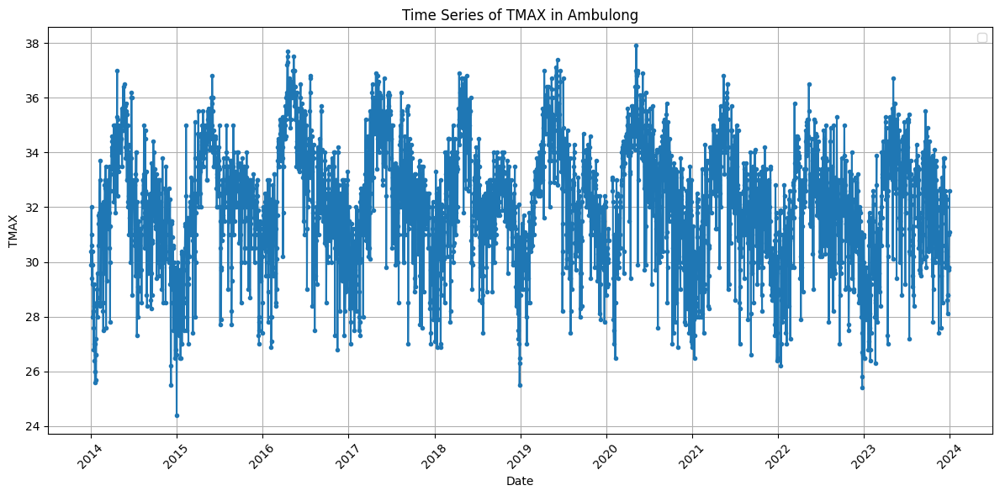

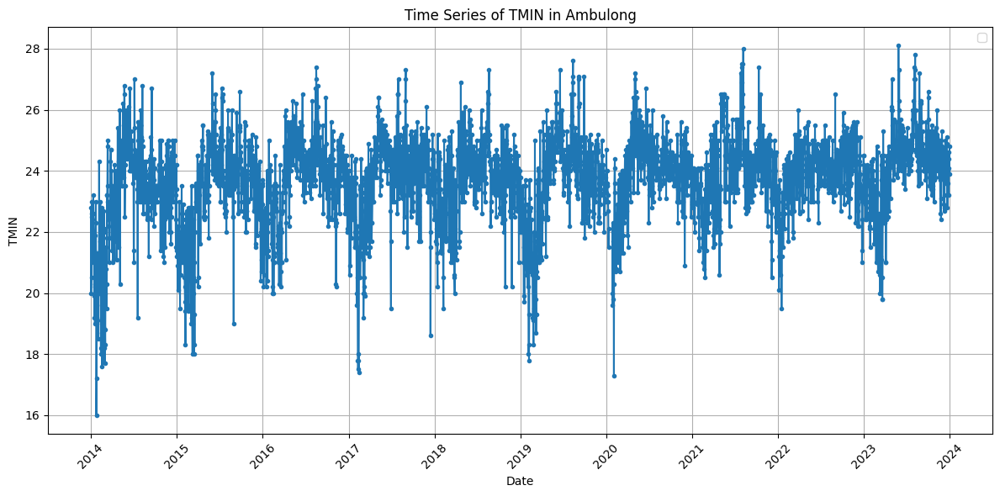

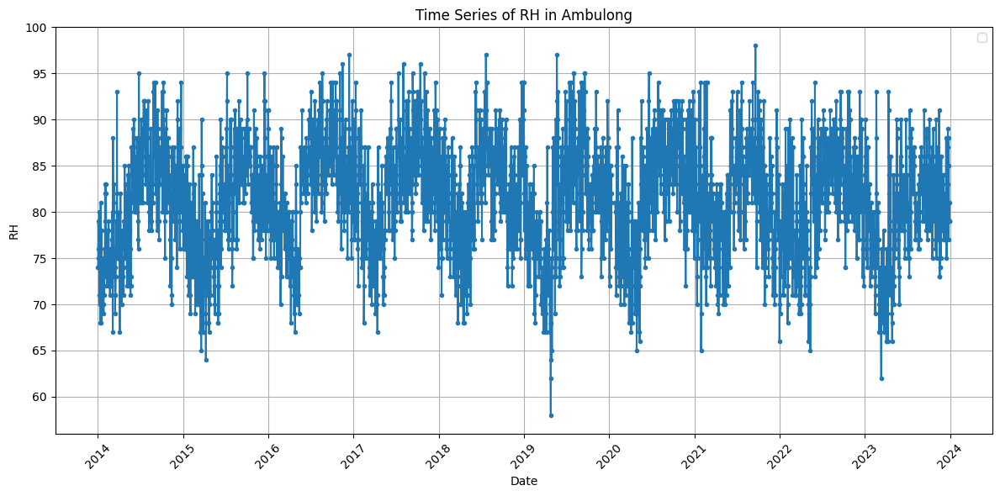

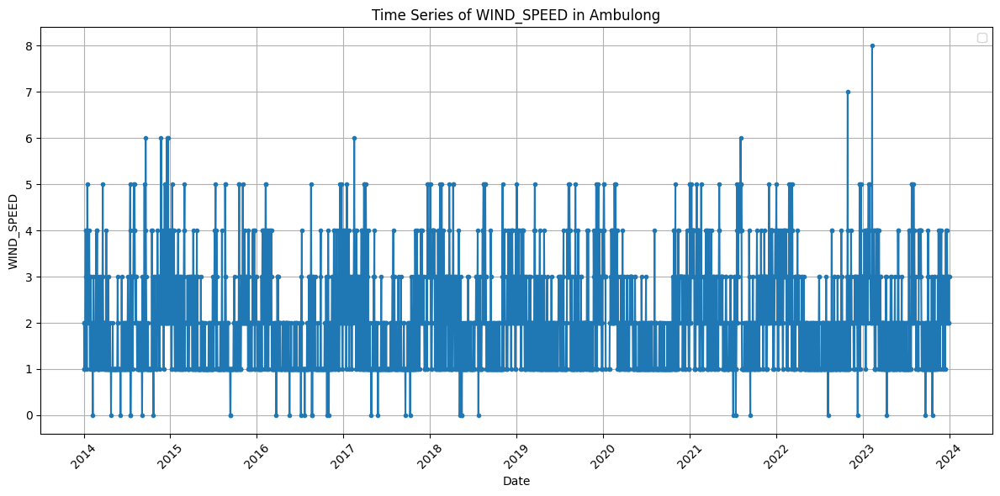

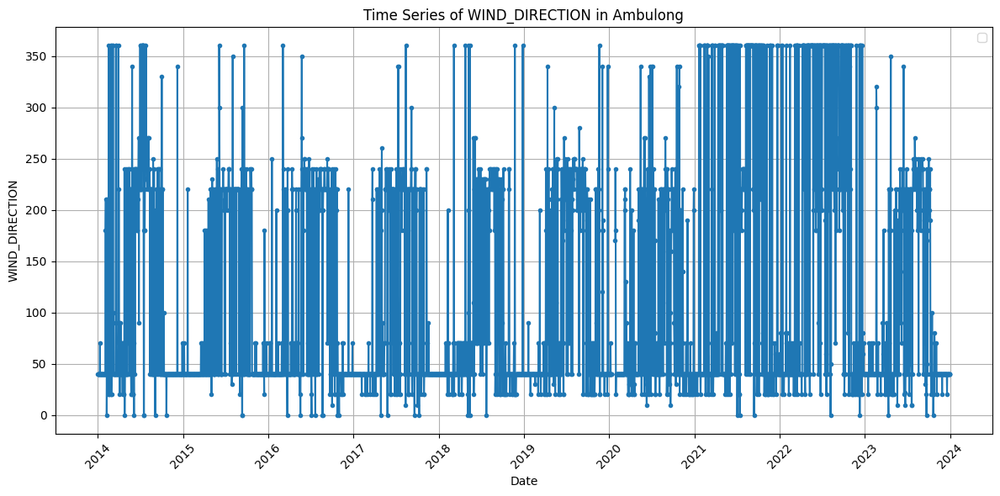

...

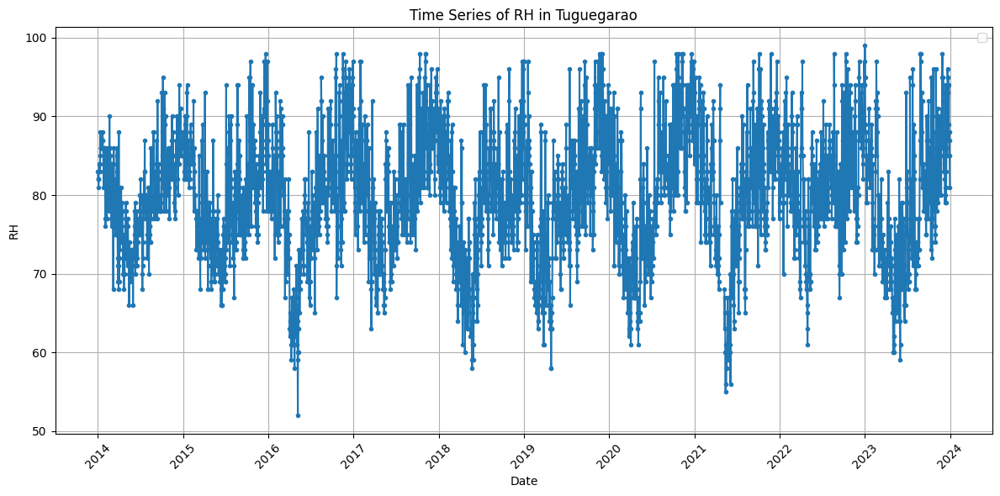

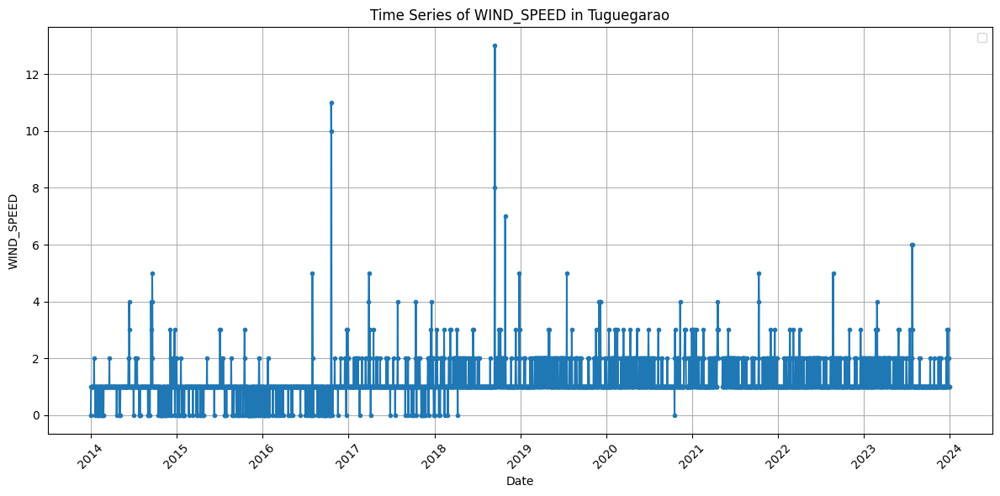

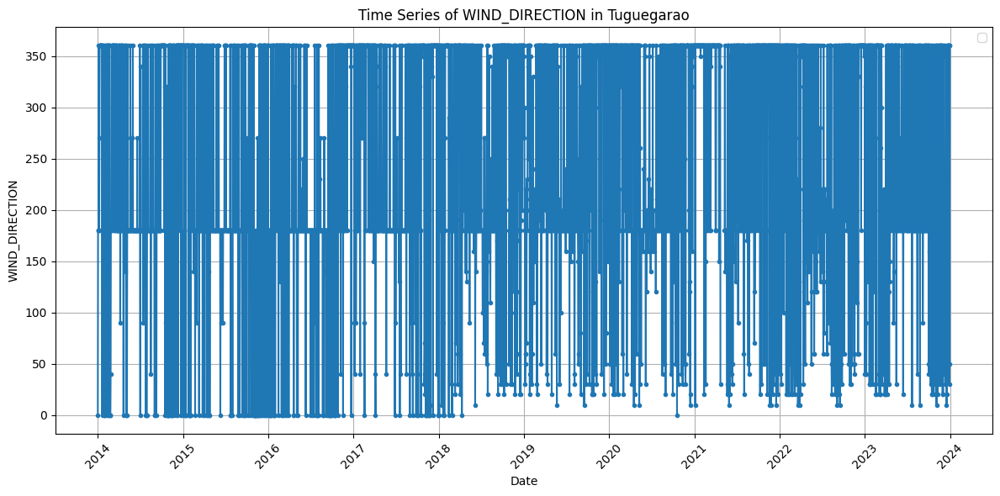

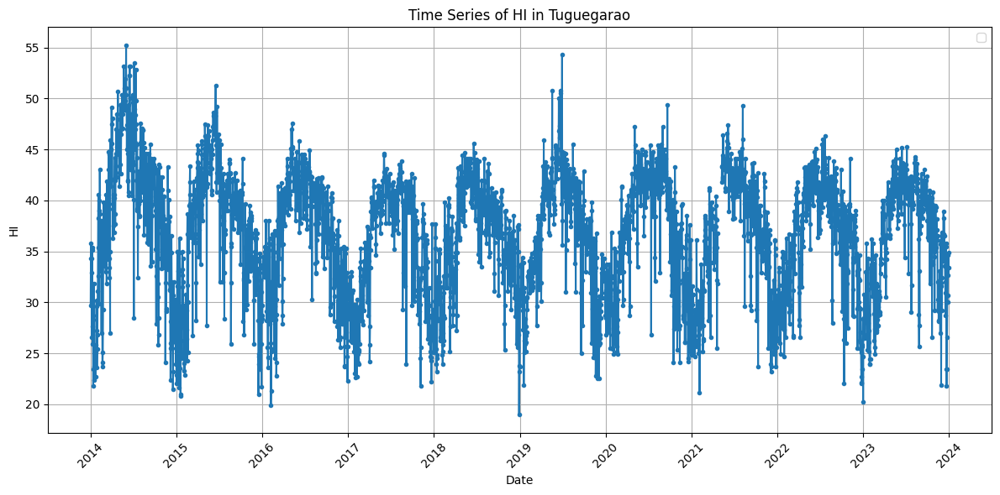

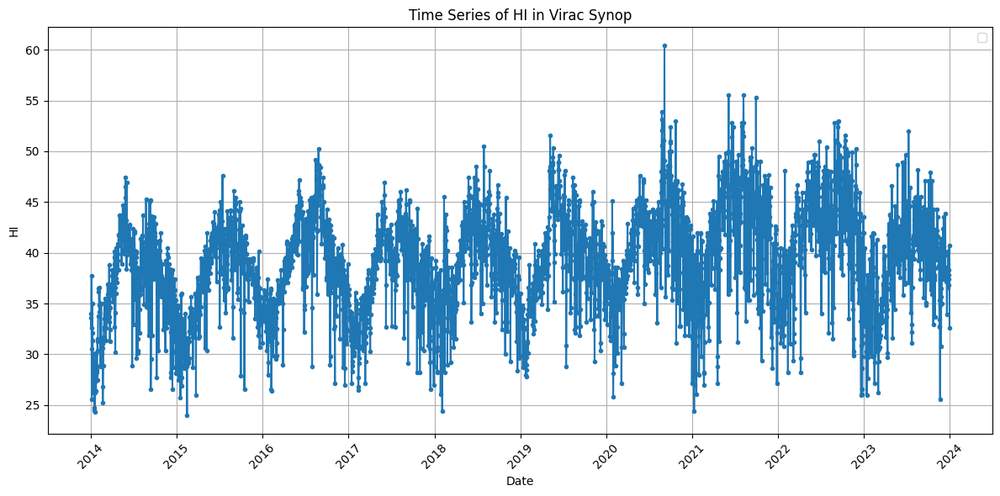

In [16]:
for df, name in zip(dataframes, dataframe_names):
    missing_cols = missing_value_columns[name]
    if missing_cols:
        plot_time_series_with_missing_values(df, missing_cols)

In [17]:
import pandas as pd
import numpy as np

def impute_station_data(df_station, alpha=0.7):
    """
    Gap-aware imputation for one station DataFrame.
    Expects columns: ['Date','TMAX','TMIN','RH','WIND_SPEED','WIND_DIRECTION', 'HI']
    -999.0 are treated as NaN.
    Returns DataFrame with imputed columns and recomputed 'HI'.
    """
    df = df_station.copy()
    # Ensure Datetime and sorted
    df = df.sort_values('Date').set_index('Date')

    # Replace sentinel with NaN
    df = df.replace(-999.0, np.nan)

    # --- Create circular components for WIND_DIRECTION early (so they appear in climatology) ---
    if 'WIND_DIRECTION' in df.columns:
        # WIND_DIRECTION may be NaN; np.sin(np.deg2rad(np.nan)) -> nan (ok)
        df['WIND_DIRECTION_sin'] = np.sin(np.deg2rad(df['WIND_DIRECTION']))
        df['WIND_DIRECTION_cos'] = np.cos(np.deg2rad(df['WIND_DIRECTION']))

    # --- Build climatologies and fallbacks ---
    # dayofyear climatology (1..366)
    climatology = df.groupby(df.index.dayofyear).mean()
    # monthly climatology fallback
    monthly_clim = df.groupby(df.index.month).mean()
    # global means as last fallback
    global_means = df.mean()

    # Helper: get fallback climatology value for a given Date and column
    def get_clim_value(Date, col):
        doy = Date.dayofyear
        mon = Date.month
        if col in climatology.columns:
            val = climatology.at[doy, col]
            if not pd.isna(val):
                return val
        # try monthly
        if col in monthly_clim.columns:
            mval = monthly_clim.at[mon, col]
            if not pd.isna(mval):
                return mval
        # final fallback
        return global_means.get(col, np.nan)

    # --- Utility: find consecutive NaN runs using boolean mask iteration ---
    def find_nan_runs(series):
        mask = series.isna().to_numpy()
        runs = []
        n = len(mask)
        i = 0
        while i < n:
            if mask[i]:
                start = i
                while i+1 < n and mask[i+1]:
                    i += 1
                end = i
                runs.append((start, end))
            i += 1
        return runs

    # --- Imputation function for a single scalar column ---
    def impute_scalar(s, colname):
        s = s.copy()
        if s.notna().sum() == 0:
            # nothing observed -> fill with global mean (or NaN if not available)
            fill_val = get_clim_value(s.index[0], colname)
            return s.fillna(fill_val)

        # Precompute an interpolated series limited to short gaps
        interp_full = s.interpolate(method='time', limit=3, limit_direction='both')
        rolling = s.rolling(window=7, min_periods=1, center=True).mean()

        runs = find_nan_runs(s)
        for start_pos, end_pos in runs:
            gap_len = end_pos - start_pos + 1
            idx_range = s.index[start_pos:end_pos+1]

            if gap_len <= 3:
                # Short gap: take interpolation result for those indices
                s.loc[idx_range] = interp_full.loc[idx_range]

            elif gap_len <= 14:
                # Medium gap: blended rolling + climatology
                clim_series = pd.Series([get_clim_value(d, colname) for d in s.index], index=s.index)
                blended = alpha * rolling + (1 - alpha) * clim_series
                s.loc[idx_range] = blended.loc[idx_range]

            else:
                # Long gap: use climatology day-of-year with fallback
                clim_vals = [get_clim_value(d, colname) for d in idx_range]
                s.loc[idx_range] = clim_vals

        # final safety fill (if any NaNs left) with global mean
        s = s.fillna(global_means.get(colname, np.nan))
        return s

    # --- Apply to scalar meteorological columns ---
    for col in ['TMAX','TMIN','RH','WIND_SPEED', 'HI']:
        if col in df.columns:
            df[col] = impute_scalar(df[col], col)

    # --- Wind direction: impute sin/cos then convert back ---
    if 'WIND_DIRECTION' in df.columns:
        df['WIND_DIRECTION_sin'] = impute_scalar(df['WIND_DIRECTION_sin'], 'WIND_DIRECTION_sin')
        df['WIND_DIRECTION_cos'] = impute_scalar(df['WIND_DIRECTION_cos'], 'WIND_DIRECTION_cos')
        # Reconstruct direction in degrees 0..360
        WIND_DIRECTION_rad = np.arctan2(df['WIND_DIRECTION_sin'], df['WIND_DIRECTION_cos'])
        df['WIND_DIRECTION'] = (np.rad2deg(WIND_DIRECTION_rad) + 360) % 360
        df = df.drop(columns=['WIND_DIRECTION_sin','WIND_DIRECTION_cos'])

    return df.reset_index()


In [18]:
# Fill missing values in all datasets
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    df.name = name  # Ensure name attribute is set
    # Print current dataset being processed
    print(f"Imputing missing values for dataset: {df.name}")
    dataframes[i] = impute_station_data(df)
    # Check if any NaNs remain
    if dataframes[i].isna().sum().sum() == 0:
        print(f"All missing values imputed for dataset: {df.name}")
    else:
        print(f"Warning: Some missing values remain in dataset: {df.name}")

Imputing missing values for dataset: Ambulong
All missing values imputed for dataset: Ambulong
Imputing missing values for dataset: Baguio
All missing values imputed for dataset: Baguio
Imputing missing values for dataset: Baler
All missing values imputed for dataset: Baler
Imputing missing values for dataset: Basco
All missing values imputed for dataset: Basco
Imputing missing values for dataset: Cabatuan & CLSU
All missing values imputed for dataset: Cabatuan & CLSU
Imputing missing values for dataset: Calapan
All missing values imputed for dataset: Calapan
Imputing missing values for dataset: Clark
All missing values imputed for dataset: Clark
Imputing missing values for dataset: Daet
All missing values imputed for dataset: Daet
Imputing missing values for dataset: Dagupan
All missing values imputed for dataset: Dagupan
Imputing missing values for dataset: Iba
All missing values imputed for dataset: Iba
Imputing missing values for dataset: Infanta
All missing values imputed for data

In [19]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI   Latitude   Longitude  Elevation  
0  34.3  14.090081  121.055244         11  
1  33.3  14.090081  121.055244         11  
2  35.9  14.090081  121.055244         11  
3  38.0  14.090081  121.055244         11  
4  34.7  14.090081  121.055244         11  

Dataframe Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3652 entries, 0 to 3651
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype         
---  ------  

/tmp/ipython-input-2376163538.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


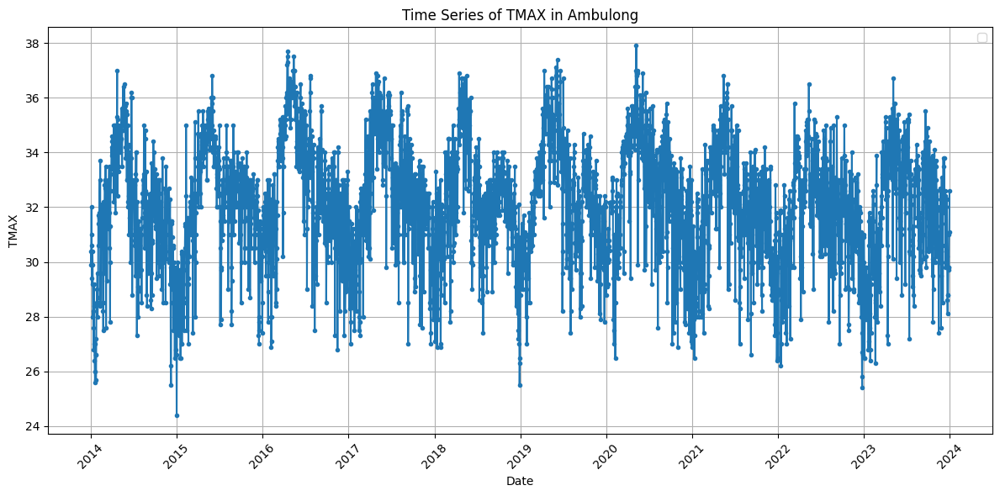

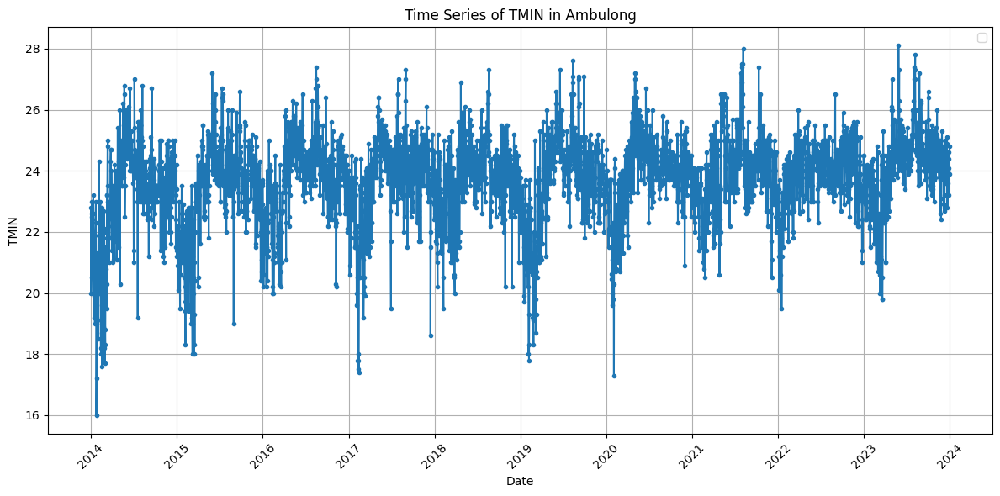

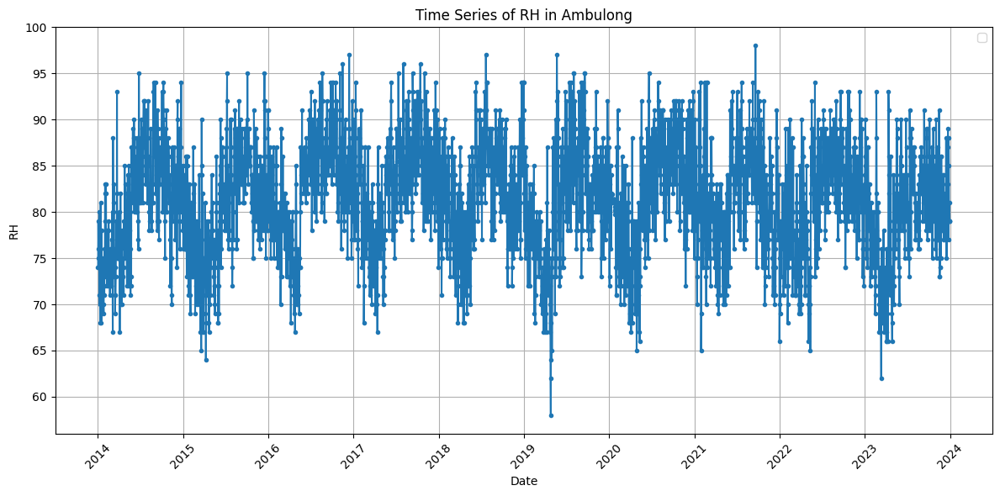

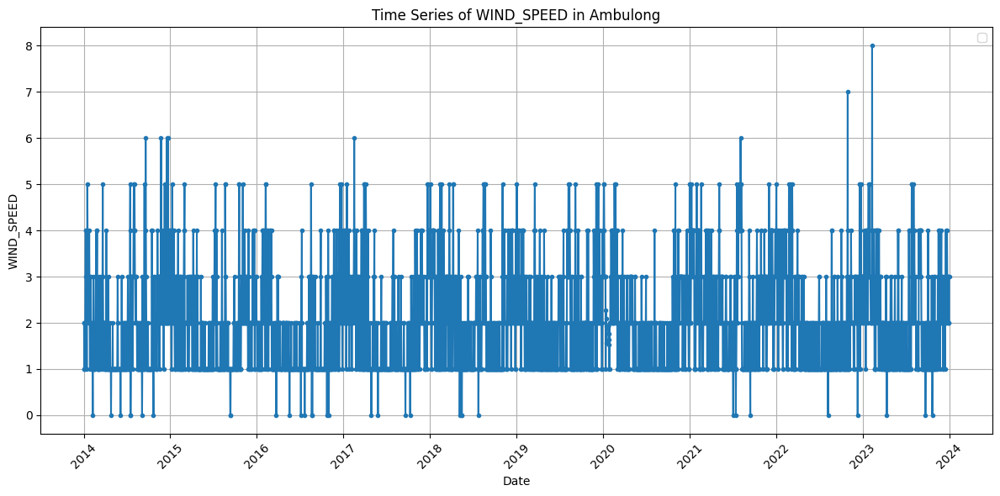

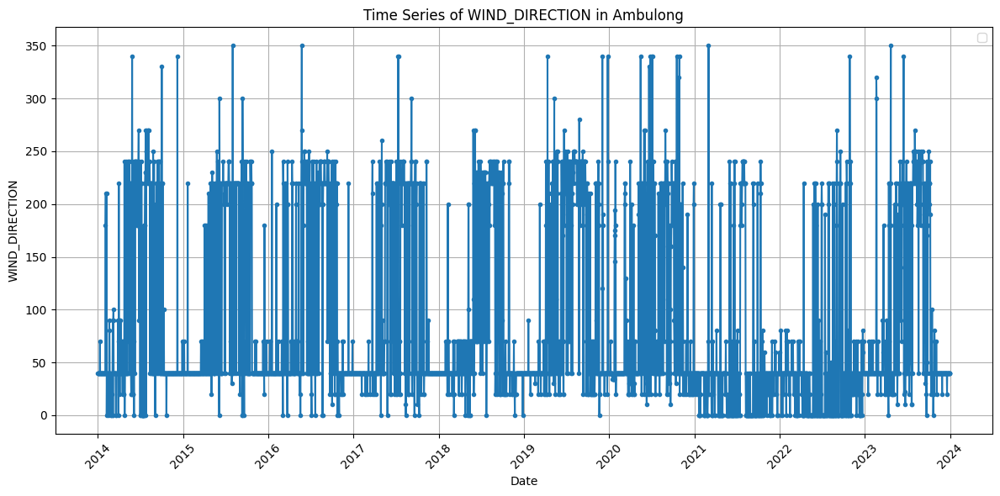

...

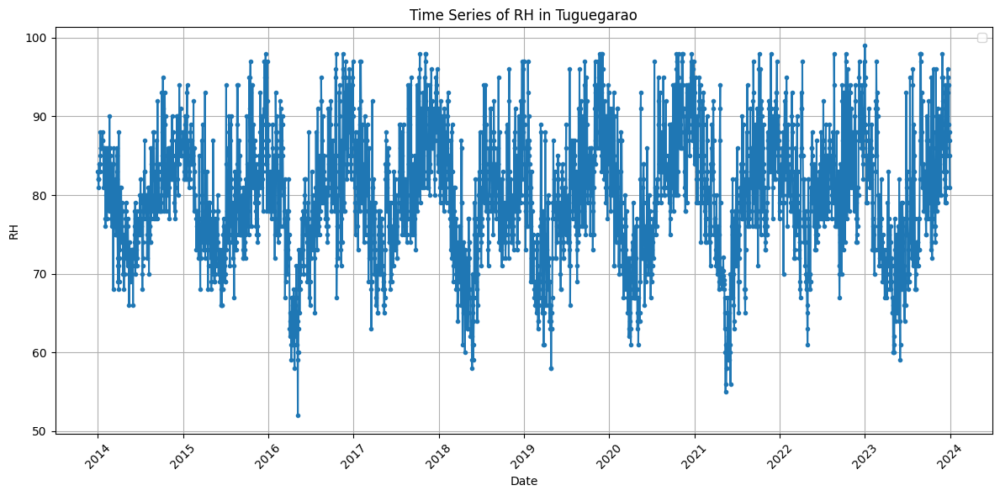

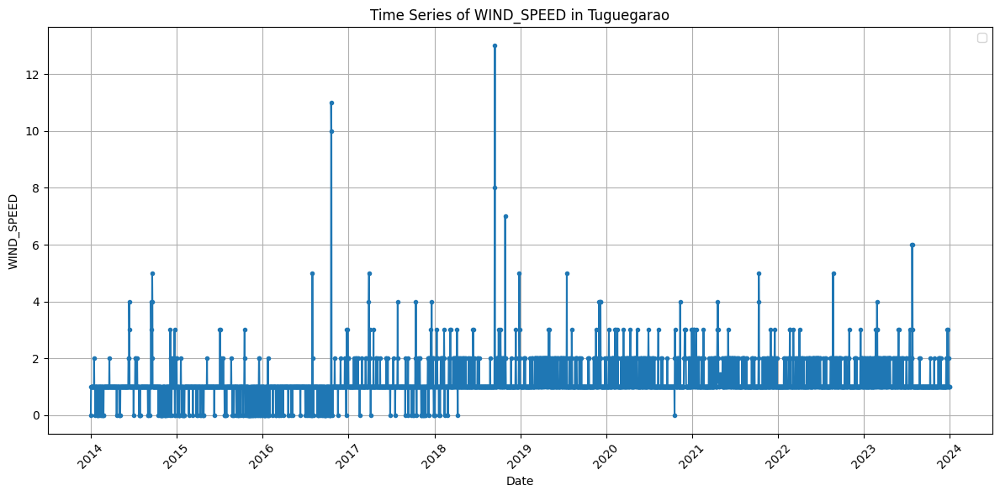

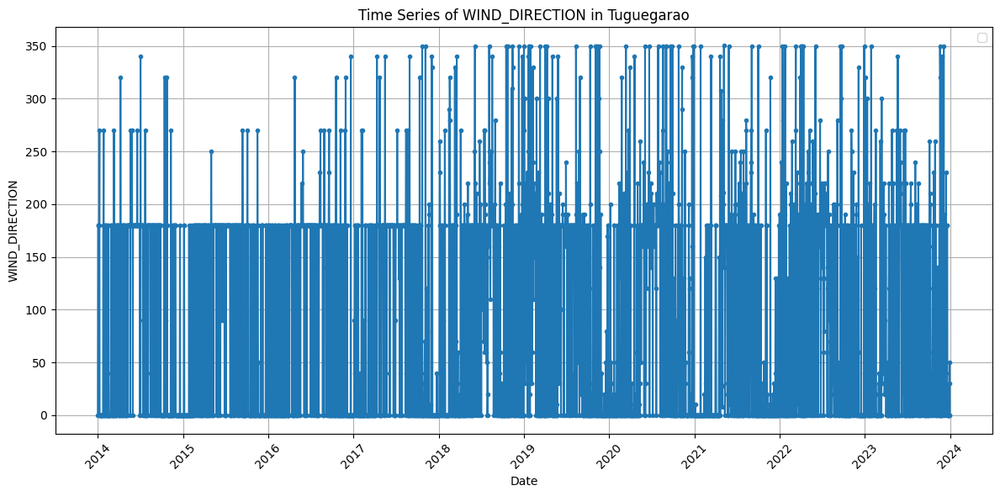

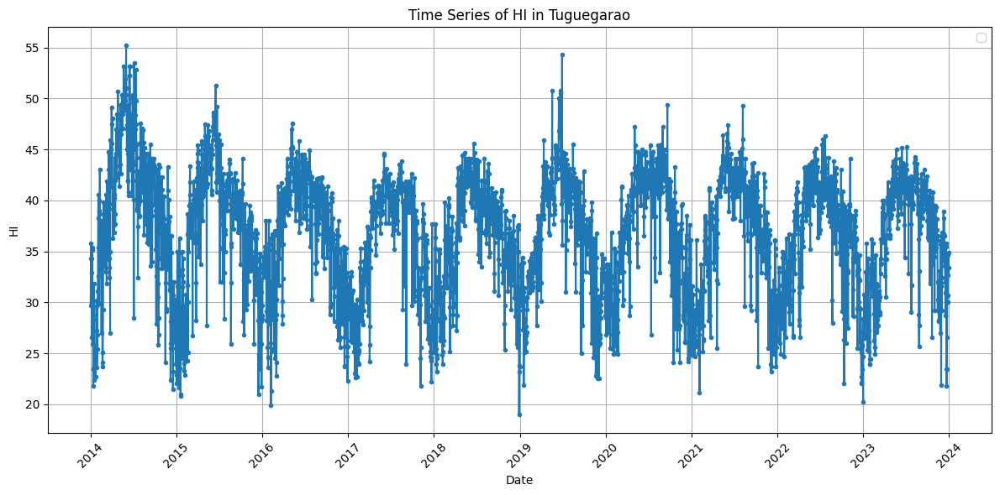

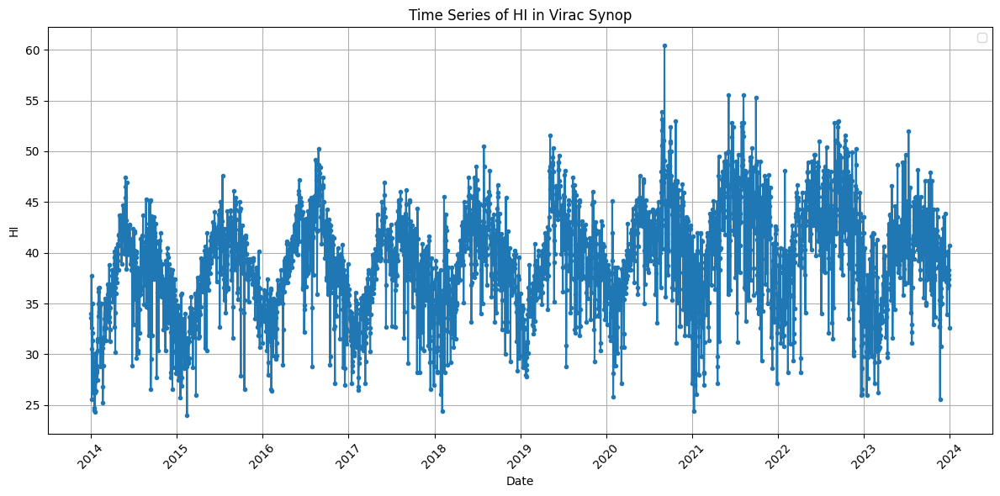

In [20]:
# Plot the time series of original missing features for each dataset after imputation to verify no missing values remain
missing_value_columns
for df, name in zip(dataframes, dataframe_names):
    missing_cols = missing_value_columns[name]
    if missing_cols:
        plot_time_series_with_missing_values(df, missing_cols)

In [22]:
# Plot time-series graph for each column in df_heat_index. Date(UTC) on x-axis, and each column on y-axis.
def plot_heat_index_time_series(df):
    for col in df.columns:
        if col != 'Date(UTC)':
            plt.figure(figsize=(12, 6))
            plt.plot(df['Date(UTC)'], df[col], marker='o', linestyle='-', markersize=3)
            plt.title(f'Time Series of {col}')
            plt.xlabel('Date(UTC)')
            plt.ylabel(col)
            plt.xticks(rotation=45)
            plt.grid()
            plt.legend()
            plt.tight_layout()
            plt.show()

In [24]:
# Check for null values in all dataframes except heat index dataframe
for df, name in zip(dataframes, dataframe_names):
    null_counts = df.isna().sum()
    total_nulls = null_counts.sum()
    if total_nulls == 0:
        print(f"No null values in dataset: {name}")
    else:
        print(f"Dataset: {name} has {total_nulls} null values in columns:\n{null_counts[null_counts > 0]}")

No null values in dataset: Ambulong
No null values in dataset: Baguio
No null values in dataset: Baler
No null values in dataset: Basco
No null values in dataset: Cabatuan & CLSU
No null values in dataset: Calapan
No null values in dataset: Clark
No null values in dataset: Daet
No null values in dataset: Dagupan
No null values in dataset: Iba
No null values in dataset: Infanta
No null values in dataset: Laoag
No null values in dataset: Legazpi
No null values in dataset: NAIA
No null values in dataset: Port Area
No null values in dataset: Puerto Princesa
No null values in dataset: San Jose
No null values in dataset: Sangley Point
No null values in dataset: Science Garden
No null values in dataset: Sinait
No null values in dataset: Tanay
No null values in dataset: Tayabas
No null values in dataset: Tuguegarao
No null values in dataset: Virac Synop


In [25]:
# Check if the number of rows are matching for all dataframes, else print the number of rows for each dataframe
num_rows = [len(df) for df in dataframes]
if len(set(num_rows)) == 1:
    print(f"All datasets have the same number of rows: {num_rows[0]}")
else:
    for df, name in zip(dataframes, dataframe_names):
        print(f"Dataset: {name} has {len(df)} rows")


All datasets have the same number of rows: 3652


In [26]:
# Include Station Column for each dataframe
for df, name in zip(dataframes, dataframe_names):
    df['Station'] = name

In [27]:
def create_rothfusz_vectorized(T_celsius, RH_percent):
    """
    Calculates the Rothfusz heat index for entire pandas Series at once.
    This version handles potential negative values in the sqrt calculation.
    T_celsius: Temperature in Celsius
    RH_percent: Relative Humidity in percentage (0-100)
    Returns a pandas Series of the Heat Index in Celsius.
    """
    # 1. Convert T to Fahrenheit
    T_fahrenheit = T_celsius * 9/5 + 32

    # 2. Calculate the core Rothfusz regression formula
    HI_fahrenheit = (-42.379 + 2.04901523 * T_fahrenheit + 10.14333127 * RH_percent
                     - 0.22475541 * T_fahrenheit * RH_percent - 6.83783e-3 * T_fahrenheit**2
                     - 5.481717e-2 * RH_percent**2 + 1.22874e-3 * T_fahrenheit**2 * RH_percent
                     + 8.5282e-4 * T_fahrenheit * RH_percent**2 - 1.99e-6 * T_fahrenheit**2 * RH_percent**2)

    # 3. Apply the two specific Rothfusz adjustments using numpy.where
    # Adjustment for low humidity
    cond1 = (RH_percent < 13) & (T_fahrenheit >= 80) & (T_fahrenheit <= 112)
    # Clamp the value inside sqrt to be non-negative
    sqrt_val = np.maximum(0, (17 - np.abs(T_fahrenheit - 95)) / 17)
    adjustment1 = ((13 - RH_percent) / 4) * np.sqrt(sqrt_val)
    HI_fahrenheit = np.where(cond1, HI_fahrenheit - adjustment1, HI_fahrenheit)

    # Adjustment for high humidity
    cond2 = (RH_percent > 85) & (T_fahrenheit >= 80) & (T_fahrenheit <= 87)
    adjustment2 = ((RH_percent - 85) / 10) * ((87 - T_fahrenheit) / 5)
    HI_fahrenheit = np.where(cond2, HI_fahrenheit + adjustment2, HI_fahrenheit)

    # 4. Apply the simplified formulas for lower temperatures
    # For T < 79°F
    HI_fahrenheit = np.where(T_fahrenheit < 79, -10.3 + 1.1 * T_fahrenheit + 0.047 * RH_percent, HI_fahrenheit)

    # For T <= 40°F
    HI_fahrenheit = np.where(T_fahrenheit <= 40, T_fahrenheit, HI_fahrenheit)

    # 5. Convert the final result back to Celsius
    HI_celsius = (HI_fahrenheit - 32) * 5/9
    return HI_celsius

In [28]:
# Create new column 'HI_Calculated' in each dataframe using create_rothfusz function
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    df['HI_Calculated'] = create_rothfusz_vectorized(df['TMAX'], df['RH'])
    df['Rothfusz_Residuals'] = df['HI'] - df['HI_Calculated']
    average_residuals = np.average(df['Rothfusz_Residuals'])
    dataframes[i] = df  # Update the dataframe in the list
    print(f"Calculated HI_Calculated for dataset: {name}, MAE: {average_residuals}")

Calculated HI_Calculated for dataset: Ambulong, MAE: -7.4307327350831
Calculated HI_Calculated for dataset: Baguio, MAE: -0.7835725408647901
Calculated HI_Calculated for dataset: Baler, MAE: -5.814903702357505
Calculated HI_Calculated for dataset: Basco, MAE: -2.7368508693966964
Calculated HI_Calculated for dataset: Cabatuan & CLSU, MAE: -8.536823782705516
Calculated HI_Calculated for dataset: Calapan, MAE: -8.19688049760058
Calculated HI_Calculated for dataset: Clark, MAE: -6.41786324288669
Calculated HI_Calculated for dataset: Daet, MAE: -5.0693253166710965
Calculated HI_Calculated for dataset: Dagupan, MAE: -6.715404101416505
Calculated HI_Calculated for dataset: Iba, MAE: -5.136959699770815
Calculated HI_Calculated for dataset: Infanta, MAE: -6.628212333534284
Calculated HI_Calculated for dataset: Laoag, MAE: -4.860328984057159
Calculated HI_Calculated for dataset: Legazpi, MAE: -5.07150448322037
Calculated HI_Calculated for dataset: NAIA, MAE: -7.2402292366646375
Calculated HI_Cal

In [29]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI   Latitude   Longitude  Elevation   Station  HI_Calculated  \
0  34.3  14.090081  121.055244         11  Ambulong      37.130392   
1  33.3  14.090081  121.055244         11  Ambulong      35.772566   
2  35.9  14.090081  121.055244         11  Ambulong      40.524793   
3  38.0  14.090081  121.055244         11  Ambulong      42.709972   
4  34.7  14.090081  121.055244         11  Ambulong      37.990952   

   Rothfusz_Residuals  
0       

/tmp/ipython-input-1087723066.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


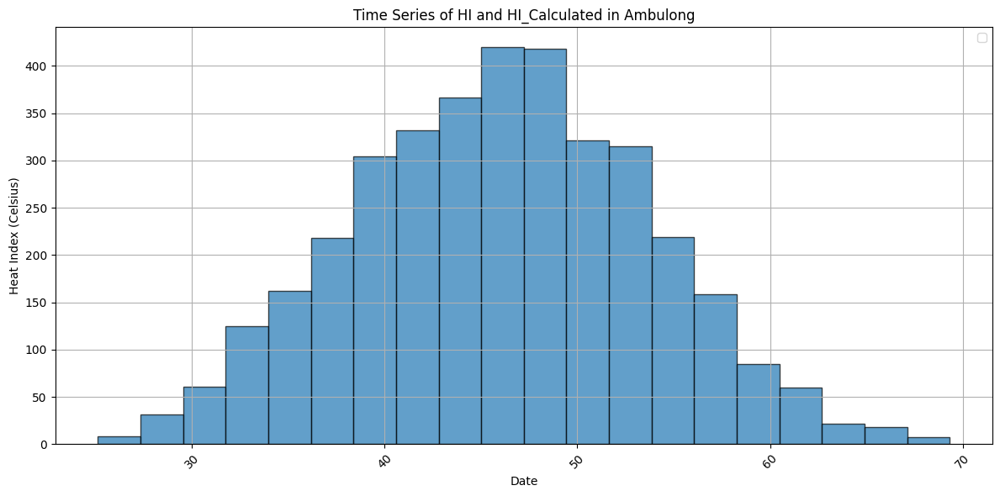

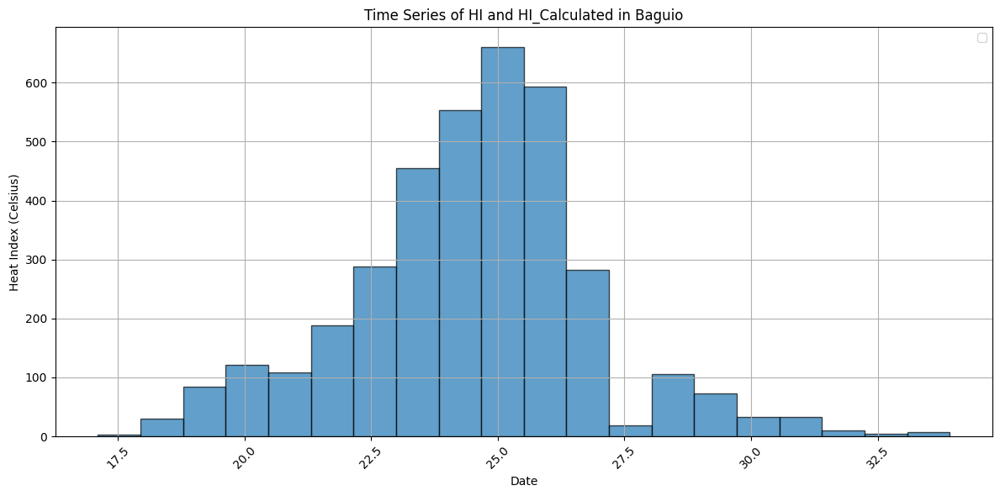

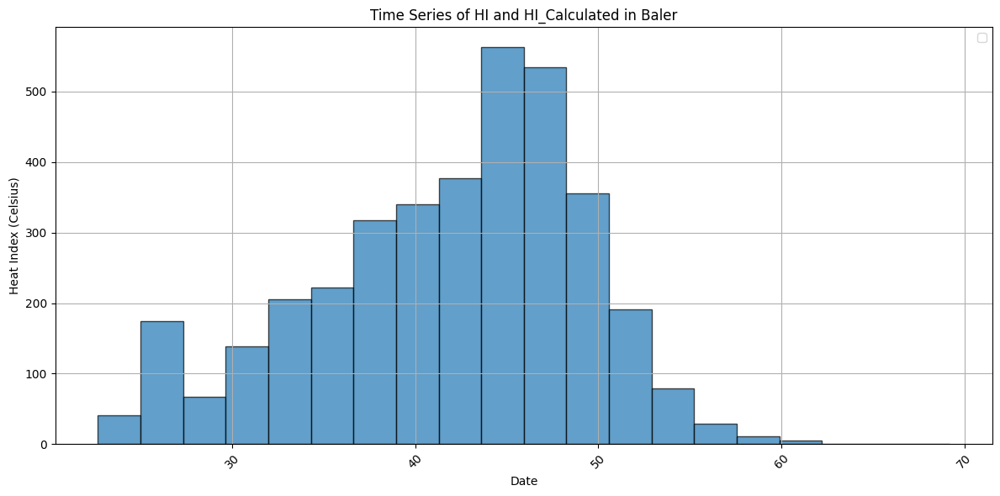

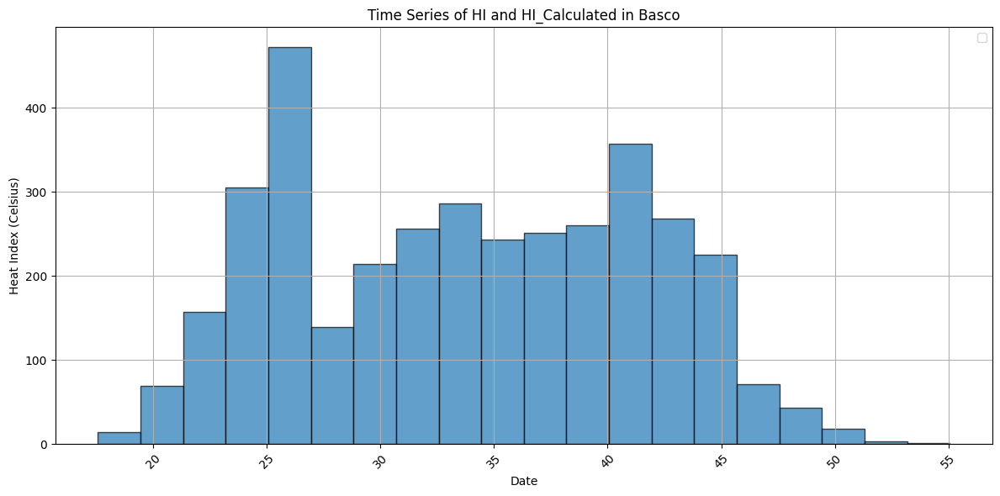

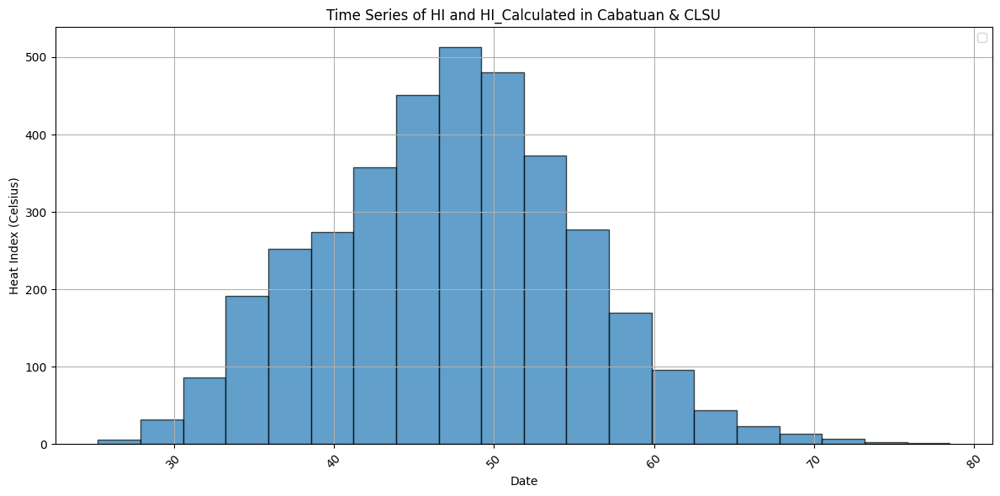

...

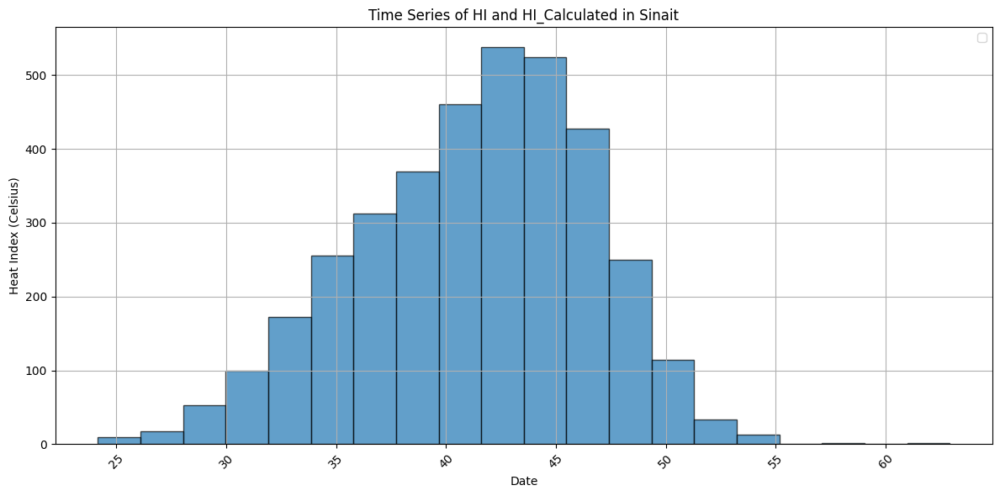

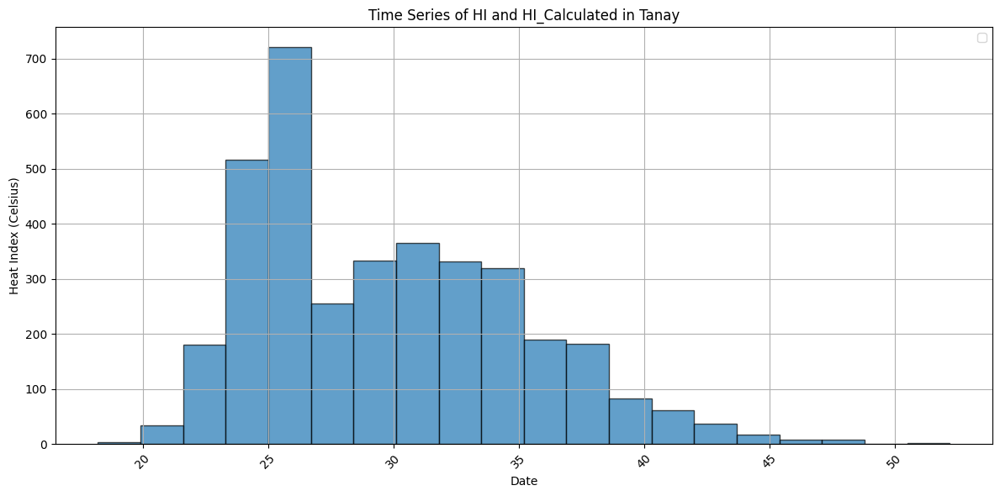

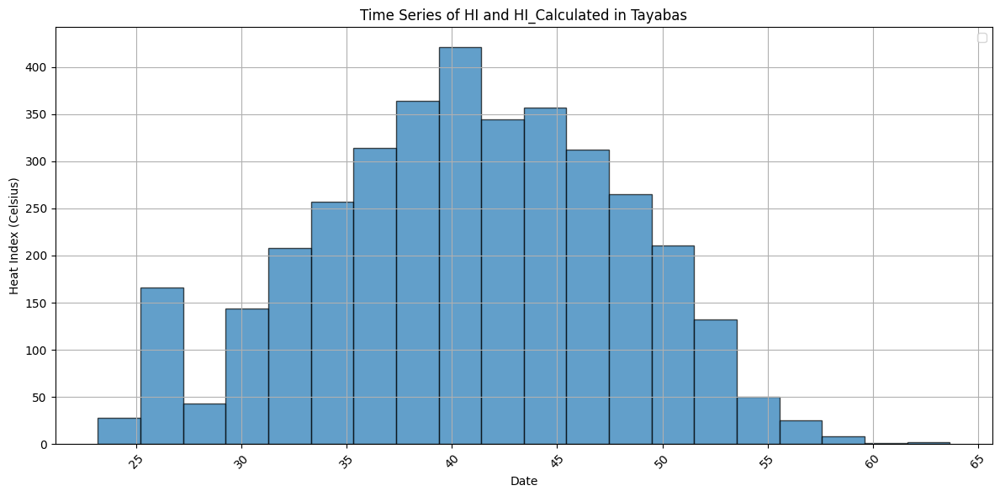

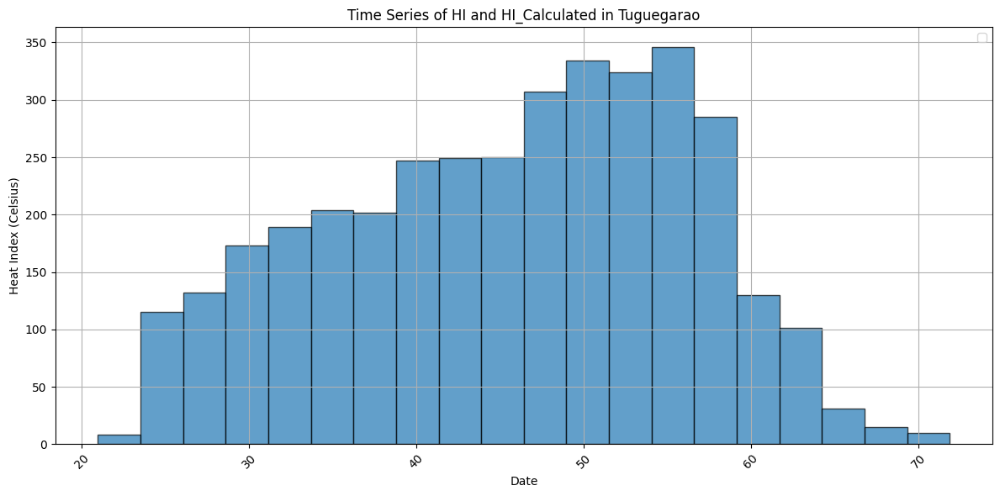

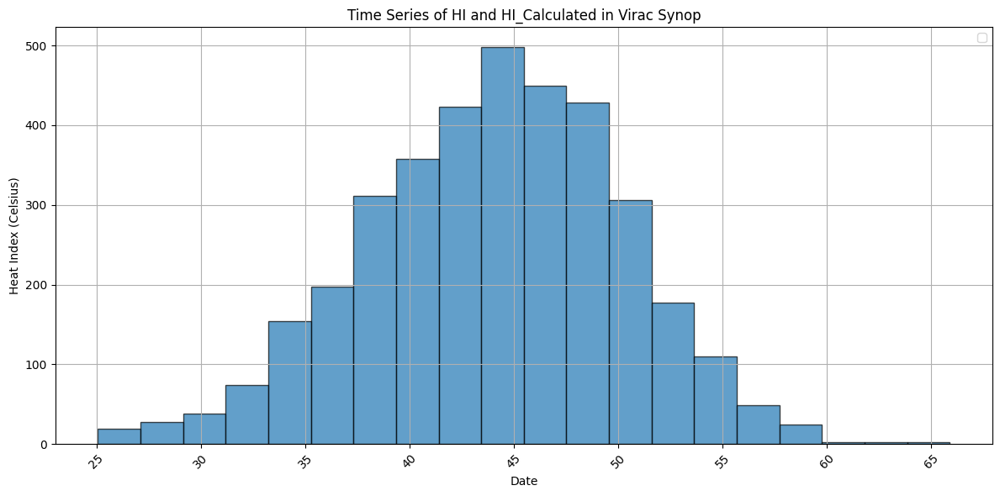

In [30]:
# Plot time-series graph of HI and HI_Calculated for each dataset. Date on x-axis, HI and HI_Calculated on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.hist(df['HI_Calculated'], bins=20, edgecolor='black', alpha=0.7)
    plt.title(f'Time Series of HI and HI_Calculated in {name}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

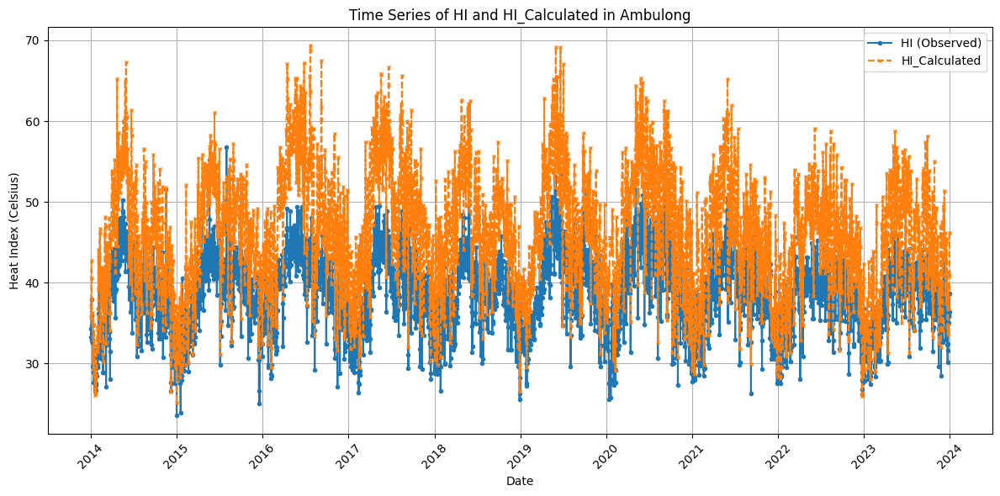

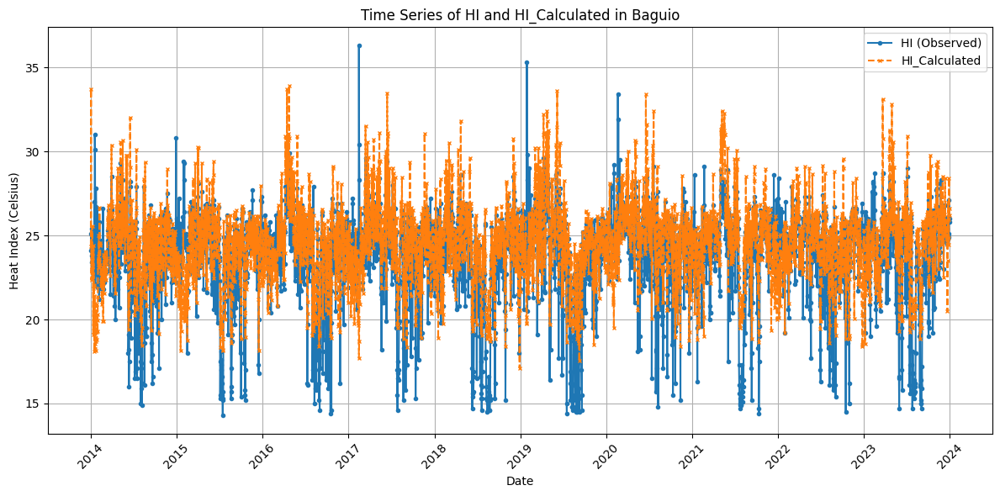

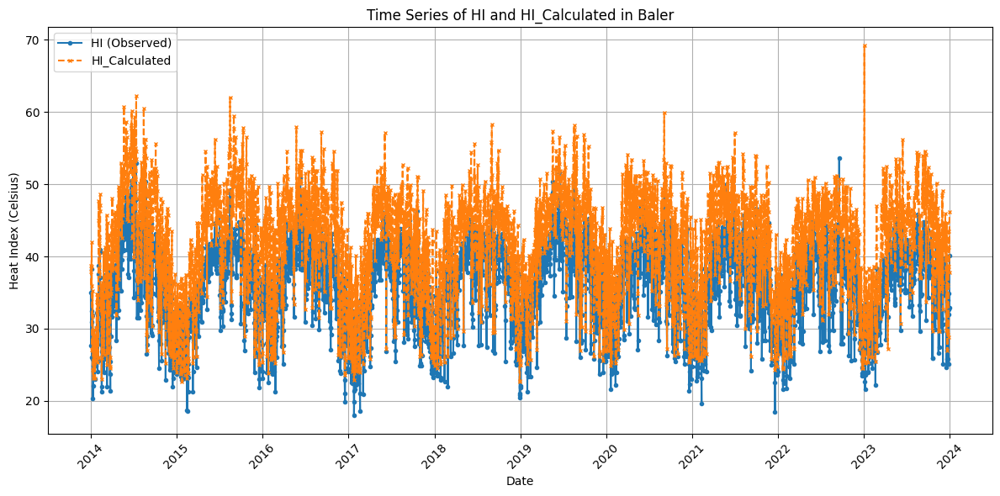

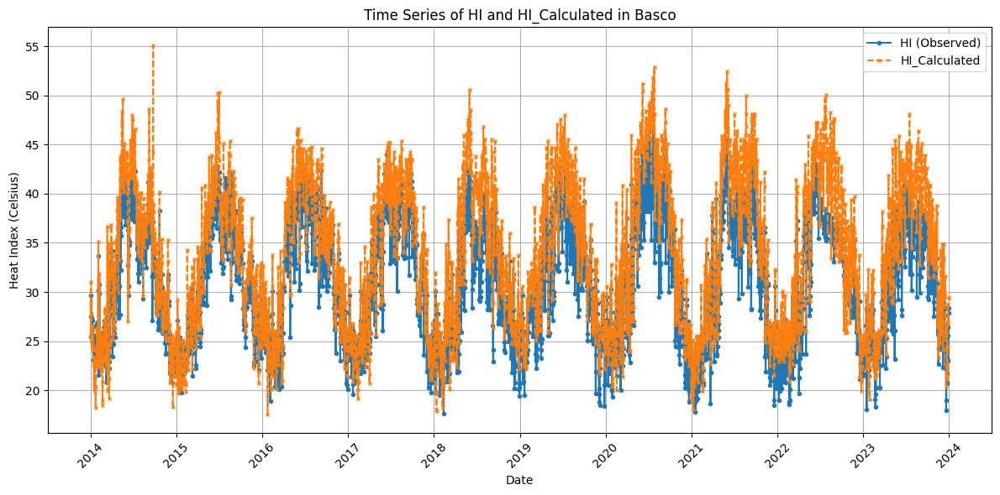

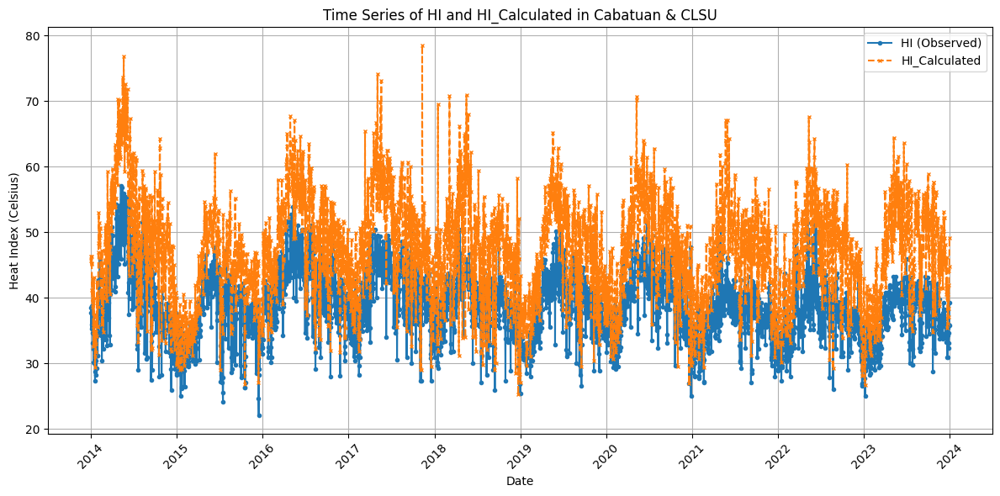

...

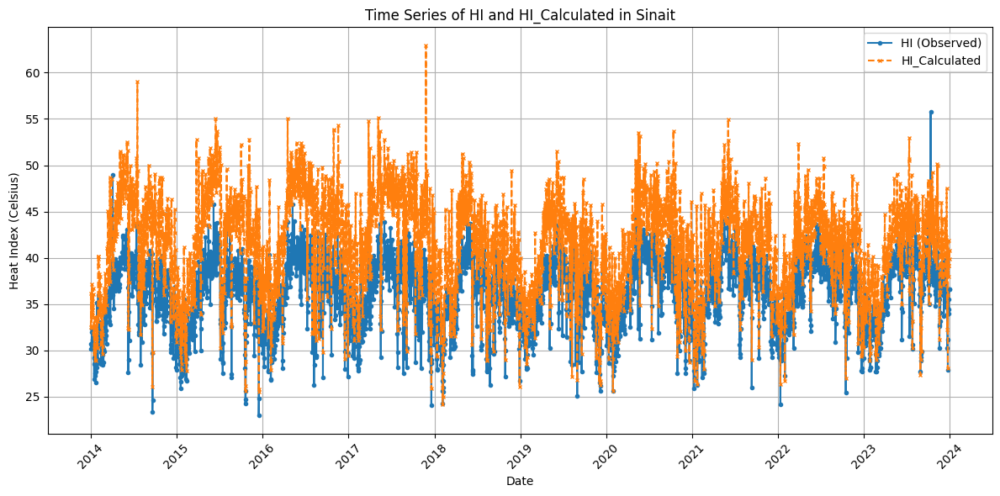

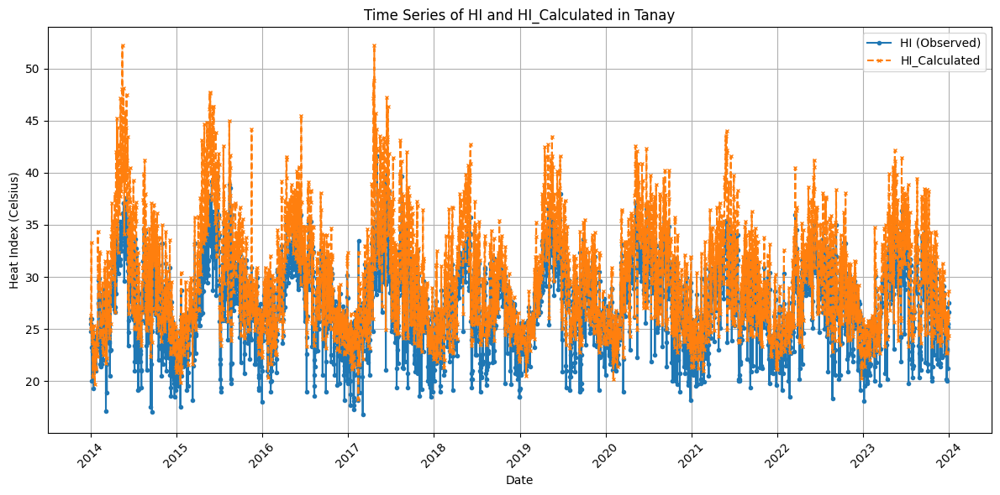

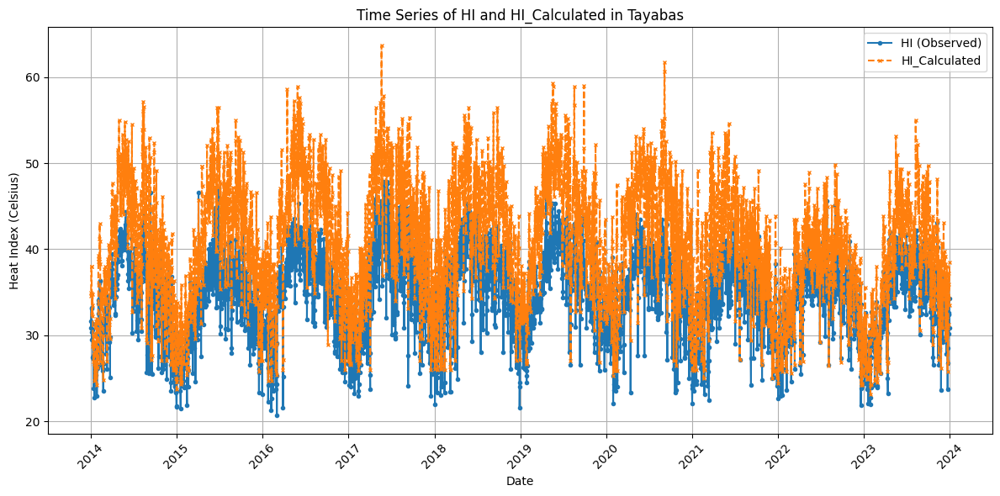

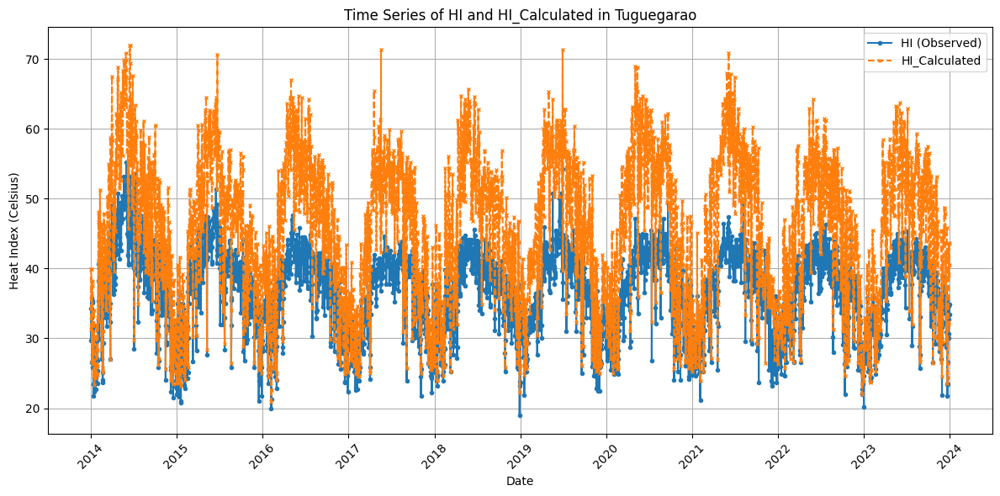

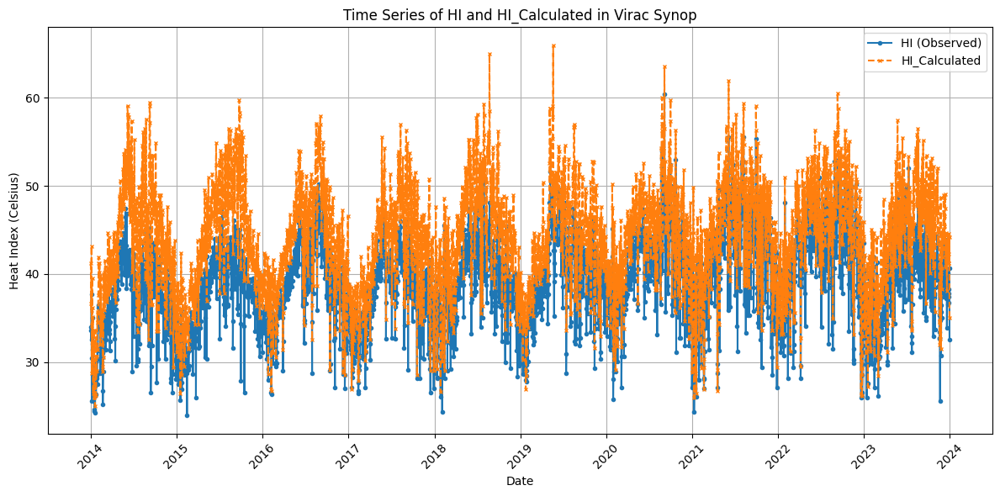

In [31]:
# Plot time-series graph of HI and HI_Calculated for each dataset. Date on x-axis, HI and HI_Calculated on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.plot(df['Date'], df['HI'], marker='o', linestyle='-', markersize=3, label='HI (Observed)')
    plt.plot(df['Date'], df['HI_Calculated'], marker='x', linestyle='--', markersize=3, label='HI_Calculated')
    plt.title(f'Time Series of HI and HI_Calculated in {name}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

In [32]:
# Calculate Saturation Vapor Pressure (SVP), Vapor Pressure Deficit (VPD), and actual Vapor Pressure using TMAX and RH
def add_vpd_features_TMAX(df):

    # Saturation Vapor Pressure using Tetens formula
    df['Saturation Vapor Pressure'] = 0.6108 * np.exp((17.27 * df['TMAX']) / (df['TMAX'] + 237.3))

    # Actual Vapor Pressure (kPa)
    df['Actual Vapor Pressure'] = (df['RH'] / 100.0) * df['Saturation Vapor Pressure']

    # Vapor Pressure Deficit (kPa)
    df['Vapor Pressure Deficit'] = df['Saturation Vapor Pressure'] - df['Actual Vapor Pressure']

    return df


In [33]:
df_ambulong.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3652 entries, 0 to 3651
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   YEAR            3652 non-null   int64         
 1   MONTH           3652 non-null   int64         
 2   DAY             3652 non-null   int64         
 3   TMAX            3638 non-null   float64       
 4   TMIN            3638 non-null   float64       
 5   RH              3635 non-null   float64       
 6   WIND_SPEED      3638 non-null   float64       
 7   WIND_DIRECTION  3638 non-null   float64       
 8   HI              3647 non-null   float64       
 9   Latitude        3652 non-null   float64       
 10  Longitude       3652 non-null   float64       
 11  Elevation       3652 non-null   int64         
 12  Date            3652 non-null   datetime64[ns]
dtypes: datetime64[ns](1), float64(8), int64(4)
memory usage: 371.0 KB


In [34]:
def add_quadratic_interaction_features(df):
    df['T^2'] = df['TMAX']**2
    df['RH^2'] = df['RH']**2
    df['TxRH'] = df['TMAX'] * df['RH']

    return df

In [35]:
def add_wetbulb_temperature(df):
    term1 = df['TMAX'] * np.arctan(0.151977 * np.sqrt(df['RH'] + 8.313659))
    term2 = np.arctan(df['TMAX'] + df['RH'])
    term3 = np.arctan(df['RH'] - 1.676331)
    term4 = 0.00391838 * df['RH']**1.5 * np.arctan(0.023101 * df['RH'])

    df['Tw'] = term1 + term2 - term3 + term4 - 4.686035
    return df

In [36]:
# Create diurnal temperature range (DTR) feature using TMAX and TMIN
def add_dtr_feature(df):
    df['DTR'] = df['TMAX'] - df['TMIN']
    return df

In [37]:
# Create lag features for HI.
def create_lag_features(df, column, lagdays):
    for lag in range(1, lagdays):
        df[f'{column}_lag_{lag}'] = df[column].shift(lag)
    return df

In [38]:
# Create multi-step ahead target variable for HI (2-day ahead)
def create_multi_step_target(df, column, steps_ahead):
    for step in range(1, steps_ahead + 1):
        df[f'{column}_{step}day_forecast'] = df[column].shift(-step)
    return df

In [39]:
# Create 5-day HI Rolling Mean and STD feature
def add_rolling_windows(df):
    df['HI_Rolling_Mean_5'] = df['HI'].rolling(window=5).mean()
    df['HI_Rolling_STD_5'] = df['HI'].rolling(window=5).std()
    df['TMAX_Rolling_Max_5'] = df['TMAX'].rolling(window=5).max()
    df['RH_Rolling_Min_5'] = df['RH'].rolling(window=5).min()
    df = df.dropna().reset_index(drop=True)  # Drop rows with NaN values after lagging
    return df

In [40]:
# Create Wind Vector Components (U and V) from WIND_SPEED and WIND_DIRECTION
def add_wind_vector_components(df):
    # Convert WIND_DIRECTION from degrees to radians
    wind_dir_rad = np.deg2rad(df['WIND_DIRECTION'])

    # Calculate U and V components
    df['U_wind_component'] = df['WIND_SPEED'] * np.sin(wind_dir_rad)
    df['V_wind_component'] = df['WIND_SPEED'] * np.cos(wind_dir_rad)

    return df

In [41]:
# Create Cyclical Encoding for Month & Day
def add_cyclical_features(df):
    df['Month_sin'] = np.sin(2 * np.pi * df['MONTH'] / 12)
    df['Month_cos'] = np.cos(2 * np.pi * df['MONTH'] / 12)
    df['Day_sin'] = np.sin(2 * np.pi * df['DAY'] / 31)
    df['Day_cos'] = np.cos(2 * np.pi * df['DAY'] / 31)
    return df

In [42]:
# Create Day of Year feature and cyclical encoding
def add_day_of_year_feature(df):
    df['Day_of_Year'] = df['Date'].dt.dayofyear
    df['Day_of_Year_sin'] = np.sin(2 * np.pi * df['Day_of_Year'] / 365.25)
    df['Day_of_Year_cos'] = np.cos(2 * np.pi * df['Day_of_Year'] / 365.25)
    return df

In [43]:
for i in range(len(dataframes)):
    '''dataframes[i] = create_lag_features(dataframes[i], 'HI', 5)
    dataframes[i] = create_lag_features(dataframes[i], 'TMAX', 3)
    dataframes[i] = create_lag_features(dataframes[i], 'RH', 3)'''
    dataframes[i] = create_multi_step_target(dataframes[i], 'HI', 2)
    dataframes[i] = add_dtr_feature(dataframes[i])
    dataframes[i] = add_vpd_features_TMAX(dataframes[i])
    dataframes[i] = add_wetbulb_temperature(dataframes[i])
    dataframes[i] = add_quadratic_interaction_features(dataframes[i])

    conditions = [
        (df['HI'] >= 27) & (df['HI'] <= 32),
        (df['HI'] >= 33) & (df['HI'] <= 41),
        (df['HI'] >= 42) & (df['HI'] <= 51),
    ]
    choices = [1, 2, 3]

    dataframes[i]['Effect_classification'] = np.select(conditions, choices, default=4)

    dataframes[i].dropna(inplace=True)
    # dataframes[i] = add_rolling_windows(dataframes[i])
    dataframes[i] = add_wind_vector_components(dataframes[i])
    dataframes[i] = add_cyclical_features(dataframes[i])
    dataframes[i] = add_day_of_year_feature(dataframes[i])


In [44]:
'''# Check updated dataframes for lag features
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} with lag features")
    print(df[[f'HI_lag_{lag}' for lag in range(1,5)]].head(10))
    print("\n" + "="*50 + "\n")'''

'# Check updated dataframes for lag features\nfor df, name in zip(dataframes, dataframe_names):\n    print(f"Dataset: {name} with lag features")\n    print(df[[f\'HI_lag_{lag}\' for lag in range(1,5)]].head(10))\n    print("\n" + "="*50 + "\n")'

In [45]:
# Check HI, HI_Calculated, HI_1day_forecast, HI_2day_forecast columns for one dataframe
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} with HI features")
    print(df[['HI', 'HI_Calculated', 'HI_1day_forecast', 'HI_2day_forecast']].head(10))
    print("\n" + "="*50 + "\n")

Dataset: Ambulong with HI features
     HI  HI_Calculated  HI_1day_forecast  HI_2day_forecast
0  34.3      37.130392              33.3              35.9
1  33.3      35.772566              35.9              38.0
2  35.9      40.524793              38.0              34.7
3  38.0      42.709972              34.7              32.8
4  34.7      37.990952              32.8              32.6
5  32.8      35.635743              32.6              33.0
6  32.6      35.303814              33.0              32.5
7  33.0      36.299862              32.5              29.6
8  32.5      34.795697              29.6              29.8
9  29.6      31.355768              29.8              28.9


Dataset: Baguio with HI features
     HI  HI_Calculated  HI_1day_forecast  HI_2day_forecast
0  25.1      24.361667              24.1              24.2
1  24.1      33.693425              24.2              23.8
2  24.2      22.344444              23.8              23.4
3  23.8      23.025000              23.4     

In [46]:
# Check how many rows per dataframe after creating lag features
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} has {len(df)} rows after creating new features.")

Dataset: Ambulong has 3650 rows after creating new features.
Dataset: Baguio has 3650 rows after creating new features.
Dataset: Baler has 3650 rows after creating new features.
Dataset: Basco has 3650 rows after creating new features.
Dataset: Cabatuan & CLSU has 3650 rows after creating new features.
Dataset: Calapan has 3650 rows after creating new features.
Dataset: Clark has 3650 rows after creating new features.
Dataset: Daet has 3650 rows after creating new features.
Dataset: Dagupan has 3650 rows after creating new features.
Dataset: Iba has 3650 rows after creating new features.
Dataset: Infanta has 3650 rows after creating new features.
Dataset: Laoag has 3650 rows after creating new features.
Dataset: Legazpi has 3650 rows after creating new features.
Dataset: NAIA has 3650 rows after creating new features.
Dataset: Port Area has 3650 rows after creating new features.
Dataset: Puerto Princesa has 3650 rows after creating new features.
Dataset: San Jose has 3650 rows after cr

In [47]:
# Check null values in each dataframe after creating lag features
for df, name in zip(dataframes, dataframe_names):
    null_counts = df.isna().sum()
    total_nulls = null_counts.sum()
    if total_nulls == 0:
        print(f"No null values in dataset: {name}")
    else:
        print(f"Dataset: {name} has {total_nulls} null values in columns:\n{null_counts[null_counts > 0]}")

No null values in dataset: Ambulong
No null values in dataset: Baguio
No null values in dataset: Baler
No null values in dataset: Basco
No null values in dataset: Cabatuan & CLSU
No null values in dataset: Calapan
No null values in dataset: Clark
No null values in dataset: Daet
No null values in dataset: Dagupan
No null values in dataset: Iba
No null values in dataset: Infanta
No null values in dataset: Laoag
No null values in dataset: Legazpi
No null values in dataset: NAIA
No null values in dataset: Port Area
No null values in dataset: Puerto Princesa
No null values in dataset: San Jose
No null values in dataset: Sangley Point
No null values in dataset: Science Garden
No null values in dataset: Sinait
No null values in dataset: Tanay
No null values in dataset: Tayabas
No null values in dataset: Tuguegarao
No null values in dataset: Virac Synop


In [48]:
# Show info() of one dataframe as example
dataframes[0].info()

<class 'pandas.core.frame.DataFrame'>
Index: 3650 entries, 0 to 3649
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       3650 non-null   datetime64[ns]
 1   YEAR                       3650 non-null   int64         
 2   MONTH                      3650 non-null   int64         
 3   DAY                        3650 non-null   int64         
 4   TMAX                       3650 non-null   float64       
 5   TMIN                       3650 non-null   float64       
 6   RH                         3650 non-null   float64       
 7   WIND_SPEED                 3650 non-null   float64       
 8   WIND_DIRECTION             3650 non-null   float64       
 9   HI                         3650 non-null   float64       
 10  Latitude                   3650 non-null   float64       
 11  Longitude                  3650 non-null   float64       
 12  Elevation  

## Handling of Numerical and Categorical Values

In [49]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI  ...  Effect_classification  U_wind_component  V_wind_component  \
0  34.3  ...                      2          1.285575          1.532089   
1  33.3  ...                      2          1.285575          1.532089   
2  35.9  ...                      4          0.642788          0.766044   
3  38.0  ...                      2          0.642788          0.766044   
4  34.7  ...                      4          1.285575          1.532089   

  

In [50]:
# Merge all dataframes into a single dataframe
df_merged = pd.concat(dataframes, ignore_index=True)
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87600 entries, 0 to 87599
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       87600 non-null  datetime64[ns]
 1   YEAR                       87600 non-null  int64         
 2   MONTH                      87600 non-null  int64         
 3   DAY                        87600 non-null  float64       
 4   TMAX                       87600 non-null  float64       
 5   TMIN                       87600 non-null  float64       
 6   RH                         87600 non-null  float64       
 7   WIND_SPEED                 87600 non-null  float64       
 8   WIND_DIRECTION             87600 non-null  float64       
 9   HI                         87600 non-null  float64       
 10  Latitude                   87600 non-null  float64       
 11  Longitude                  87600 non-null  float64       
 12  Elev

In [51]:
# Export merged dataframe to CSV for future use
# df_merged.to_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/merged_station_data.csv', index=False)

In [52]:
# Label encoding for Station column
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_merged['Station'] = le.fit_transform(df_merged['Station'])

# Check unique values in Station column
print(f"Unique stations after label encoding: {df_merged['Station'].nunique()}")

Unique stations after label encoding: 24


In [53]:
# Unmerge dataframes back to individual dataframes
dataframes = [df_merged[df_merged['Station'] == i].reset_index(drop=True) for i in range(df_merged['Station'].nunique())]
for i, df in enumerate(dataframes):
    df.name = dataframe_names[i]
    print(f"Dataset: {df.name} has {len(df)} rows after unmerging.")

Dataset: Ambulong has 3650 rows after unmerging.
Dataset: Baguio has 3650 rows after unmerging.
Dataset: Baler has 3650 rows after unmerging.
Dataset: Basco has 3650 rows after unmerging.
Dataset: Cabatuan & CLSU has 3650 rows after unmerging.
Dataset: Calapan has 3650 rows after unmerging.
Dataset: Clark has 3650 rows after unmerging.
Dataset: Daet has 3650 rows after unmerging.
Dataset: Dagupan has 3650 rows after unmerging.
Dataset: Iba has 3650 rows after unmerging.
Dataset: Infanta has 3650 rows after unmerging.
Dataset: Laoag has 3650 rows after unmerging.
Dataset: Legazpi has 3650 rows after unmerging.
Dataset: NAIA has 3650 rows after unmerging.
Dataset: Port Area has 3650 rows after unmerging.
Dataset: Puerto Princesa has 3650 rows after unmerging.
Dataset: San Jose has 3650 rows after unmerging.
Dataset: Sangley Point has 3650 rows after unmerging.
Dataset: Science Garden has 3650 rows after unmerging.
Dataset: Sinait has 3650 rows after unmerging.
Dataset: Tanay has 3650 row

## Train-Test-Split Data

In [54]:
# Train-validation-test split based on Date. Use 60% for training, 20% for validation, and 20% for testing. Ensure no data leakage by splitting based on Date ranges and for each station separately.
train_dfs, val_dfs, test_dfs = [], [], []
for df in dataframes:
    n = len(df)
    train_end = int(0.60 * n)
    val_end = int(0.80 * n)

    train_dfs.append(df.iloc[:train_end].reset_index(drop=True))
    val_dfs.append(df.iloc[train_end:val_end].reset_index(drop=True))
    test_dfs.append(df.iloc[val_end:].reset_index(drop=True))

In [55]:
# Check number of rows in each split for each station
for i, name in enumerate(dataframe_names):
    print(f"Station: {name} - Train: {len(train_dfs[i])}, Val: {len(val_dfs[i])}, Test: {len(test_dfs[i])}")

Station: Ambulong - Train: 2190, Val: 730, Test: 730
Station: Baguio - Train: 2190, Val: 730, Test: 730
Station: Baler - Train: 2190, Val: 730, Test: 730
Station: Basco - Train: 2190, Val: 730, Test: 730
Station: Cabatuan & CLSU - Train: 2190, Val: 730, Test: 730
Station: Calapan - Train: 2190, Val: 730, Test: 730
Station: Clark - Train: 2190, Val: 730, Test: 730
Station: Daet - Train: 2190, Val: 730, Test: 730
Station: Dagupan - Train: 2190, Val: 730, Test: 730
Station: Iba - Train: 2190, Val: 730, Test: 730
Station: Infanta - Train: 2190, Val: 730, Test: 730
Station: Laoag - Train: 2190, Val: 730, Test: 730
Station: Legazpi - Train: 2190, Val: 730, Test: 730
Station: NAIA - Train: 2190, Val: 730, Test: 730
Station: Port Area - Train: 2190, Val: 730, Test: 730
Station: Puerto Princesa - Train: 2190, Val: 730, Test: 730
Station: San Jose - Train: 2190, Val: 730, Test: 730
Station: Sangley Point - Train: 2190, Val: 730, Test: 730
Station: Science Garden - Train: 2190, Val: 730, Test: 73

In [56]:
# Merge all dataframes into a single dataframe
df_train = pd.concat(train_dfs, ignore_index=True)
df_val = pd.concat(val_dfs, ignore_index=True)
df_test = pd.concat(test_dfs, ignore_index=True)

In [57]:
# Scale data per station using RobustScaler from sklearn. Do not scale Date, YEAR, MONTH, DAY, Day_of_Year, Month_sin, Month_cos, Day_sin, Day_cos, Day_of_Year_sin, Day_of_Year_cos
from sklearn.preprocessing import RobustScaler
# Columns you do NOT want to scale
columns_to_exclude = [
    'Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year',
    'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos',
    'Day_of_Year', 'Day_of_Year_sin', 'Day_of_Year_cos',
    'Station', 'HI_1day_forecast', 'HI_2day_forecast', 'Effect_classification'
]

# Determine columns to scale
cols_to_scale = [col for col in df_train.columns if col not in columns_to_exclude]

# Fit on training data only
scaler = RobustScaler()
scaler.fit(df_train[cols_to_scale])

# Transform train/val/test consistently
df_train[cols_to_scale] = scaler.transform(df_train[cols_to_scale])
df_val[cols_to_scale]   = scaler.transform(df_val[cols_to_scale])
df_test[cols_to_scale]  = scaler.transform(df_test[cols_to_scale])


In [58]:
df_train['HI_1day_forecast']

,HI_1day_forecast
0,33.3
1,35.9
2,38.0
3,34.7
4,32.8
...,...
52555,33.4
52556,38.8
52557,37.4
52558,35.8


In [59]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52560 entries, 0 to 52559
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       52560 non-null  datetime64[ns]
 1   YEAR                       52560 non-null  int64         
 2   MONTH                      52560 non-null  int64         
 3   DAY                        52560 non-null  float64       
 4   TMAX                       52560 non-null  float64       
 5   TMIN                       52560 non-null  float64       
 6   RH                         52560 non-null  float64       
 7   WIND_SPEED                 52560 non-null  float64       
 8   WIND_DIRECTION             52560 non-null  float64       
 9   HI                         52560 non-null  float64       
 10  Latitude                   52560 non-null  float64       
 11  Longitude                  52560 non-null  float64       
 12  Elev

In [60]:
# Check min date and max date for each split
print(f"Train Date Range: {df_train['Date'].min()} to {df_train['Date'].max()}")
print(f"Validation Date Range: {df_val['Date'].min()} to {df_val['Date'].max()}")
print(f"Test Date Range: {df_test['Date'].min()} to {df_test['Date'].max()}")

Train Date Range: 2014-01-01 00:00:00 to 2019-12-30 00:00:00
Validation Date Range: 2019-12-31 00:00:00 to 2021-12-29 00:00:00
Test Date Range: 2021-12-30 00:00:00 to 2023-12-29 00:00:00


In [61]:
# Set X_train, y_train, X_val, y_val, X_test, y_test
X_train = df_train.drop(columns=['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'HI_Calculated', 'Rothfusz_Residuals']) # Drop lag features to avoid data leakage
y_train = df_train[['HI_1day_forecast', 'HI_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
X_val = df_val.drop(columns=['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'HI_Calculated', 'Rothfusz_Residuals'])
y_val = df_val[['HI_1day_forecast', 'HI_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
X_test = df_test.drop(columns=['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'HI_Calculated', 'Rothfusz_Residuals'])
y_test = df_test[['HI_1day_forecast', 'HI_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI

## Feature Selection

In [62]:
X = pd.concat([X_train, X_val, X_test])
y = pd.concat([y_train, y_val, y_test])
y1 = y['HI_1day_forecast']
y2 = y['HI_2day_forecast']

In [63]:
rfevc_features_y1 = []
rfevc_features_y2 = []
mutual_info_features_y1 = []
mutual_info_features_y2 = []
selected_rfr_features_y1 = []
selected_rfr_features_y2 = []

In [64]:
# Use Regression Model for Feature Selection
from sklearn.linear_model import Ridge
from sklearn.feature_selection import RFECV, mutual_info_regression, SelectKBest, f_regression
from sklearn.model_selection import KFold
def rfevc_features_selected(X, y, features_to_select, day_to_predict):
  print(f'Test DF')
  min_features_to_select = features_to_select  # Minimum number of features to consider
  clf = Ridge()
  cv = KFold(2) # Changed to KFold which is suitable for regression

  rfecv = RFECV(
      estimator=clf,
      step=1,
      cv=cv,
      scoring="neg_mean_squared_error", # Changed scoring metric to a suitable one for Regression
      min_features_to_select=min_features_to_select,
      n_jobs=2,
  )
  rfecv.fit(X, y)
  print(f"Optimal number of features for (t+{day_to_predict}): {rfecv.n_features_}")
  features_to_select = rfecv.n_features_
  selected_inc_features = X.columns[rfecv.support_]
  if day_to_predict == 1:
    rfevc_features_y1.append(selected_inc_features)
  else:
    rfevc_features_y2.append(selected_inc_features)
  print(selected_inc_features)

In [65]:
rfevc_features_selected(X, y1, 2, 1)
rfevc_features_selected(X, y2, 2, 2)

Test DF
Optimal number of features for (t+1): 26
Index(['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'HI', 'Latitude', 'Longitude',
       'Elevation', 'Station', 'DTR', 'Saturation Vapor Pressure',
       'Actual Vapor Pressure', 'Vapor Pressure Deficit', 'Tw', 'T^2', 'RH^2',
       'TxRH', 'Effect_classification', 'U_wind_component', 'V_wind_component',
       'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos', 'Day_of_Year_sin',
       'Day_of_Year_cos'],
      dtype='object')
Test DF
Optimal number of features for (t+2): 26
Index(['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'HI', 'Latitude', 'Longitude',
       'Elevation', 'Station', 'DTR', 'Saturation Vapor Pressure',
       'Actual Vapor Pressure', 'Vapor Pressure Deficit', 'Tw', 'T^2', 'RH^2',
       'TxRH', 'Effect_classification', 'U_wind_component', 'V_wind_component',
       'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos', 'Day_of_Year_sin',
       'Day_of_Year_cos'],
      dtype='object')


In [66]:
def mutual_info_features_selected(X, y, number_of_features, day_to_predict):
  print(f"Number of Features to Check: {number_of_features}")
  threshold = number_of_features  # the number of most relevant features
  high_score_features = []
  feature_scores = mutual_info_regression(X, y, random_state=0)
  for score, f_name in sorted(zip(feature_scores, X.columns), reverse=True)[:threshold]:
    high_score_features.append(f_name)
    print(f"Feature: {f_name}; Score: {score}")
  selected_df = X[high_score_features]
  # Print the features selected
  print(f"Selected Features for (t+{day_to_predict}: {selected_df.columns}")
  if day_to_predict == 1:
    mutual_info_features_y1.append(selected_df.columns)
  else:
    mutual_info_features_y2.append(selected_df.columns)

In [67]:
mutual_info_features_selected(X, y1, 26, 1)
mutual_info_features_selected(X, y2, 26, 2)

Number of Features to Check: 26
Feature: HI; Score: 0.684728692898454
Feature: Tw; Score: 0.5509626017318272
Feature: Actual Vapor Pressure; Score: 0.47800923757509306
Feature: Saturation Vapor Pressure; Score: 0.4685969639412928
Feature: TMAX; Score: 0.4685046633057084
Feature: T^2; Score: 0.46742665853176835
Feature: TMIN; Score: 0.345167740642788
Feature: Station; Score: 0.3203692906914277
Feature: Latitude; Score: 0.31704559336916827
Feature: Elevation; Score: 0.3166976985559664
Feature: Longitude; Score: 0.31648071937761024
Feature: TxRH; Score: 0.2602010300821451
Feature: Day_of_Year_cos; Score: 0.17898773264640777
Feature: Vapor Pressure Deficit; Score: 0.1671011155604054
Feature: Month_cos; Score: 0.12364323706549785
Feature: V_wind_component; Score: 0.10272305816236482
Feature: Day_of_Year_sin; Score: 0.08740056253502182
Feature: U_wind_component; Score: 0.08688448905318413
Feature: Effect_classification; Score: 0.08244952117591442
Feature: RH^2; Score: 0.07968214921430938
Fea

In [68]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

model_rf = RandomForestRegressor(random_state=42)

model_rf = RandomForestRegressor(max_depth= None, min_samples_leaf = 1, min_samples_split = 2, n_estimators=  100)
model_rf.fit(X, y1)

sel_sfm = SelectFromModel(model_rf, prefit=True)
sel_sfm_index = sel_sfm.get_support()
selected_rfe_features = X.iloc[:, sel_sfm_index]
# Include Total Household Income
print(selected_rfe_features.columns)
selected_rfr_features_y1.append(selected_rfe_features.columns)

Index(['TMAX', 'HI'], dtype='object')


In [69]:
# Check accuracy of model
from sklearn.metrics import mean_squared_error, r2_score

y_pred = model_rf.predict(X)
mse = mean_squared_error(y1, y_pred)
r2 = r2_score(y1, y_pred)

print("Mean Squared Error:", mse)
rmse = mse ** 0.5
print("Root Mean Squared Error:", rmse)
print("R-squared:", r2)

Mean Squared Error: 1.0034677615733552
Root Mean Squared Error: 1.0017323802160711
R-squared: 0.9702950252841701


In [70]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

model_rf = RandomForestRegressor(random_state=42)

model_rf = RandomForestRegressor(max_depth= None, min_samples_leaf = 1, min_samples_split = 2, n_estimators=  100)
model_rf.fit(X, y2)

sel_sfm = SelectFromModel(model_rf, prefit=True)
sel_sfm_index = sel_sfm.get_support()
selected_rfe_features = X.iloc[:, sel_sfm_index]
# Include Total Household Income
print(selected_rfe_features.columns)
selected_rfr_features_y2.append(selected_rfe_features.columns)

Index(['TMAX', 'TMIN', 'HI', 'Day_of_Year_cos'], dtype='object')


In [71]:
# Check accuracy of model
from sklearn.metrics import mean_squared_error, r2_score

y_pred = model_rf.predict(X)
mse = mean_squared_error(y2, y_pred)
r2 = r2_score(y2, y_pred)

print("Mean Squared Error:", mse)
rmse = mse ** 0.5
print("Root Mean Squared Error:", rmse)
print("R-squared:", r2)

Mean Squared Error: 1.2338568971217159
Root Mean Squared Error: 1.1107911131809238
R-squared: 0.963471268599324


In [72]:
common_features_y1 = set(mutual_info_features_y1[0]) & set(rfevc_features_y1[0])
common_features_y2 = set(mutual_info_features_y2[0]) & set(rfevc_features_y2[0])

print(f"Common features for t+1: {common_features_y1}")
print(f"Common features for t+2: {common_features_y2}")

Common features for t+1: {'TxRH', 'WIND_SPEED', 'Day_cos', 'U_wind_component', 'Day_sin', 'Effect_classification', 'Month_sin', 'Day_of_Year_cos', 'Station', 'V_wind_component', 'TMIN', 'Longitude', 'Vapor Pressure Deficit', 'RH', 'DTR', 'RH^2', 'Tw', 'TMAX', 'HI', 'Elevation', 'Month_cos', 'Latitude', 'Saturation Vapor Pressure', 'Actual Vapor Pressure', 'Day_of_Year_sin', 'T^2'}
Common features for t+2: {'TxRH', 'WIND_SPEED', 'Day_cos', 'U_wind_component', 'Day_sin', 'Effect_classification', 'Month_sin', 'Day_of_Year_cos', 'Station', 'V_wind_component', 'TMIN', 'Longitude', 'Vapor Pressure Deficit', 'RH', 'DTR', 'RH^2', 'Tw', 'TMAX', 'HI', 'Elevation', 'Month_cos', 'Latitude', 'Saturation Vapor Pressure', 'Actual Vapor Pressure', 'Day_of_Year_sin', 'T^2'}


## Model Training

In [73]:
# Create LSTM Model using PyTorch GPU to forecast 2-day ahead HI
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


In [74]:
def create_sequences_grouped(df, seq_len=14):
    """
    Create sequences per station to avoid crossing boundaries.
    Expects df to contain features + targets + 'Station'.
    """
    Xs, ys = [], []
    for station_id, station_df in df.groupby("Station"):
        X = station_df.drop(columns=["Date", "YEAR", "MONTH", "DAY", "Day_of_Year",
            "WIND_DIRECTION", "HI_1day_forecast", "HI_2day_forecast", 'HI_Calculated', 'Rothfusz_Residuals']).reset_index(drop=True)
        y = station_df[["HI_1day_forecast", "HI_2day_forecast"]].reset_index(drop=True)

        for i in range(len(X) - seq_len):
            Xs.append(X.iloc[i:i+seq_len].values)
            ys.append(y.iloc[i+seq_len].values)

    return np.array(Xs), np.array(ys)


In [ ]:
!pip install optuna --quiet

In [75]:
class EarlyStopping:
    def __init__(self, patience=10, min_delta=0.0):
        self.patience = patience
        self.min_delta = min_delta
        self.best_loss = float("inf")
        self.counter = 0
        self.early_stop = False

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True


In [ ]:
'''
Best Params: {'seq_len': 6, 'hidden_size': 256, 'num_layers': 3, 'dropout': 0.2, 'lr': 0.0005, 'batch_size': 64, 'loss': 'MSE', 'loss_param': 1.0}
Best Validation Loss: 9.259106812653718
'''

"\nBest Params: {'seq_len': 6, 'hidden_size': 256, 'num_layers': 3, 'dropout': 0.2, 'lr': 0.0005, 'batch_size': 64, 'loss': 'MSE', 'loss_param': 1.0}\nBest Validation Loss: 9.259106812653718\n"

In [76]:
# Apply on each split
seq_len = 6
X_train_seq, y_train_seq = create_sequences_grouped(df_train, seq_len)
X_val_seq, y_val_seq     = create_sequences_grouped(df_val, seq_len)
X_test_seq, y_test_seq   = create_sequences_grouped(df_test, seq_len)

print("X_train_seq:", X_train_seq.shape)  # (samples, seq_len, features)
print("y_train_seq:", y_train_seq.shape)  # (samples, 2)


X_train_seq: (52416, 6, 26)
y_train_seq: (52416, 2)


In [82]:
# Create XGBoost, LightGBM, Random Forest model to forecast HI 2days ahead
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestRegressor as rfr
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

xgb = xgb.XGBRegressor()
lgb = lgb.LGBMRegressor()
rfr = rfr()

In [84]:
xgb.fit(X_train_seq.reshape(X_train_seq.shape[0], -1), y_train_seq)
rfr.fit(X_train_seq.reshape(X_train_seq.shape[0], -1), y_train_seq)

RandomForestRegressor()

## Model Evaluation

In [ ]:
y_pred_xgb = xgb.predict(X_test_seq.reshape(X_test_seq.shape[0], -1))
y_pred_rfr = rfr.predict(X_test_seq.reshape(X_test_seq.shape[0], -1))

In [ ]:
# Check evaluation metrics for 1-day and 2-day forecast
rmse_t1_xgb = np.sqrt(mean_squared_error(y_test_seq[:, 0], y_pred_xgb[:, 0]))
mae_t1_xgb = mean_absolute_error(y_test_seq[:, 0], y_pred_xgb[:, 0])
bias_t1_xgb = np.mean(y_pred_xgb[:, 0] - y_test_seq[:, 0])

rmse_t2_xgb = np.sqrt(mean_squared_error(y_test_seq[:, 1], y_pred_xgb[:, 1]))
mae_t2_xgb = mean_absolute_error(y_test_seq[:, 1], y_pred_xgb[:, 1])
bias_t2_xgb = np.mean(y_pred_xgb[:, 1] - y_test_seq[:, 1])

In [ ]:
# Check evaluation metrics for 1-day and 2-day forecast
rmse_t1_rfr = np.sqrt(mean_squared_error(y_test_seq[:, 0], y_pred_rfr[:, 0]))
mae_t1_rfr = mean_absolute_error(y_test_seq[:, 0], y_pred_rfr[:, 0])
bias_t1_rfr = np.mean(y_pred_rfr[:, 0] - y_test_seq[:, 0])

rmse_t2_rfr = np.sqrt(mean_squared_error(y_test_seq[:, 1], y_pred_rfr[:, 1]))
mae_t2_rfr = mean_absolute_error(y_test_seq[:, 1], y_pred_rfr[:, 1])
bias_t2_rfr = np.mean(y_pred_rfr[:, 1] - y_test_seq[:, 1])

In [ ]:
# Print evaluation metrics
print("Evaluation Metrics XGB:")
print(f"t+1 (tomorrow):   RMSE = {rmse_t1_xgb:.3f}, MAE = {mae_t1_xgb:.3f}, Bias = {bias_t1_xgb:.3f}")
print(f"t+2 (day after):  RMSE = {rmse_t2_xgb:.3f}, MAE = {mae_t2_xgb:.3f}, Bias = {bias_t2_xgb:.3f}")

Evaluation Metrics XGB:
t+1 (tomorrow):   RMSE = 2.974, MAE = 2.238, Bias = -0.082
t+2 (day after):  RMSE = 3.111, MAE = 2.365, Bias = -0.193


In [ ]:
# Print evaluation metrics
print("Evaluation Metrics rfr:")
print(f"t+1 (tomorrow):   RMSE = {rmse_t1_rfr:.3f}, MAE = {mae_t1_rfr:.3f}, Bias = {bias_t1_rfr:.3f}")
print(f"t+2 (day after):  RMSE = {rmse_t2_rfr:.3f}, MAE = {mae_t2_rfr:.3f}, Bias = {bias_t2_rfr:.3f}")

Evaluation Metrics rfr:
t+1 (tomorrow):   RMSE = 2.875, MAE = 2.161, Bias = -0.135
t+2 (day after):  RMSE = 3.002, MAE = 2.272, Bias = -0.165


In [ ]:
# Put model2 in eval mode
model2.eval()
all_preds = []

with torch.no_grad():
    for X_batch, _ in test_loader:
        preds = model2(X_batch)
        all_preds.append(preds.cpu().numpy())

# Combine predictions
all_preds = np.vstack(all_preds)  # (n_samples, 2)

# Convert y_test_seq to numpy
y_test_np = y_test_seq  # already (n_samples, 2)

# --- Create results dataframe with predictions + actuals ---
results = []

# IMPORTANT: work per station to align properly
stations = df_test['Station'].unique()

start = 0
for station in stations:
    df_station = df_test[df_test['Station'] == station].reset_index(drop=True)

    # Align lengths: skip seq_len rows for station
    n_samples = len(df_station) - seq_len

    # Slice predictions & actuals for this station
    preds_station = all_preds[start:start + n_samples]
    actuals_station = y_test_np[start:start + n_samples]

    # Align with features
    X_station_aligned = df_station.iloc[seq_len:].reset_index(drop=True).copy()

    # Add predictions + actuals
    X_station_aligned['HI_1day_forecast_Pred'] = preds_station[:, 0]
    X_station_aligned['HI_2day_forecast_Pred'] = preds_station[:, 1]
    X_station_aligned['HI_1day_forecast_Actual'] = actuals_station[:, 0]
    X_station_aligned['HI_2day_forecast_Actual'] = actuals_station[:, 1]

    results.append(X_station_aligned)

    # Move pointer
    start += n_samples

# Merge everything back
df_results_by_station = pd.concat(results, ignore_index=True)

print(df_results_by_station.head())
print(df_results_by_station['Station'].unique())

        Date  YEAR  MONTH  DAY      TMAX  TMIN        RH  WIND_SPEED  \
0 2022-01-05  2022      1  5.0 -0.117647 -1.56 -0.363636         0.0   
1 2022-01-06  2022      1  6.0 -0.382353 -0.56 -0.545455         0.0   
2 2022-01-07  2022      1  7.0 -0.323529 -0.64 -0.818182         0.5   
3 2022-01-08  2022      1  8.0 -0.323529 -0.12 -0.272727         0.0   
4 2022-01-09  2022      1  9.0  0.088235 -1.04 -0.272727        -0.5   

   WIND_DIRECTION        HI  ...  Month_cos   Day_sin   Day_cos  Day_of_Year  \
0       -0.526316 -0.630137  ...   0.866025  0.848644  0.528964            5   
1       -0.315789 -0.630137  ...   0.866025  0.937752  0.347305            6   
2       -0.526316 -0.534247  ...   0.866025  0.988468  0.151428            7   
3       -0.526316 -0.287671  ...   0.866025  0.998717 -0.050649            8   
4       -0.736842 -0.082192  ...   0.866025  0.968077 -0.250653            9   

   Day_of_Year_sin  Day_of_Year_cos  HI_1day_forecast_Pred  \
0         0.085906      

In [ ]:
# Reverse label encoding for Station column
df_results_by_station['Station'] = le.inverse_transform(df_results_by_station['Station'])

In [ ]:
df_results_by_station.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17376 entries, 0 to 17375
Data columns (total 40 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       17376 non-null  datetime64[ns]
 1   YEAR                       17376 non-null  int64         
 2   MONTH                      17376 non-null  int64         
 3   DAY                        17376 non-null  float64       
 4   TMAX                       17376 non-null  float64       
 5   TMIN                       17376 non-null  float64       
 6   RH                         17376 non-null  float64       
 7   WIND_SPEED                 17376 non-null  float64       
 8   WIND_DIRECTION             17376 non-null  float64       
 9   HI                         17376 non-null  float64       
 10  Latitude                   17376 non-null  float64       
 11  Longitude                  17376 non-null  float64       
 12  Elev

In [ ]:
stations = df_results_by_station['Station'].unique()
print(stations)

['Ambulong' 'Baguio' 'Baler' 'Basco' 'Cabatuan & CLSU' 'Calapan' 'Clark'
 'Daet' 'Dagupan' 'Iba' 'Infanta' 'Laoag' 'Legazpi' 'NAIA' 'Port Area'
 'Puerto Princesa' 'San Jose' 'Sangley Point' 'Science Garden' 'Sinait'
 'Tanay' 'Tayabas' 'Tuguegarao' 'Virac Synop']


In [ ]:
# Calculate RMSE, MAE, Bias, and Correlation for each station separately and print the results
for station in stations:
    station_data = df_results_by_station[df_results_by_station['Station'] == station]
    rmse_t1 = np.sqrt(mean_squared_error(station_data['HI_1day_forecast_Actual'], station_data['HI_1day_forecast_Pred']))
    mae_t1 = mean_absolute_error(station_data['HI_1day_forecast_Actual'], station_data['HI_1day_forecast_Pred'])
    bias_t1 = np.mean(station_data['HI_1day_forecast_Pred'] - station_data['HI_1day_forecast_Actual'])
    correlation_t1 = np.corrcoef(station_data['HI_1day_forecast_Actual'], station_data['HI_1day_forecast_Pred'])[0, 1]

    rmse_t2 = np.sqrt(mean_squared_error(station_data['HI_2day_forecast_Actual'], station_data['HI_2day_forecast_Pred']))
    mae_t2 = mean_absolute_error(station_data['HI_2day_forecast_Actual'], station_data['HI_2day_forecast_Pred'])
    bias_t2 = np.mean(station_data['HI_2day_forecast_Pred'] - station_data['HI_2day_forecast_Actual'])
    correlation_t2 = np.corrcoef(station_data['HI_2day_forecast_Actual'], station_data['HI_2day_forecast_Pred'])[0, 1]

    print(f"\nStation: {station}")
    print(f"t+1 (tomorrow):   RMSE = {rmse_t1:.3f}, MAE = {mae_t1:.3f}, Bias = {bias_t1:.3f}, R = {correlation_t1:.3f}")
    print(f"t+2 (day after):  RMSE = {rmse_t2:.3f}, MAE = {mae_t2:.3f}, Bias = {bias_t2:.3f}, R = {correlation_t2:.3f}")


Station: Ambulong
t+1 (tomorrow):   RMSE = 2.859, MAE = 2.212, Bias = 0.586, R = 0.708
t+2 (day after):  RMSE = 2.918, MAE = 2.285, Bias = 0.665, R = 0.695

Station: Baguio
t+1 (tomorrow):   RMSE = 2.380, MAE = 1.738, Bias = 0.452, R = 0.561
t+2 (day after):  RMSE = 2.471, MAE = 1.795, Bias = 0.465, R = 0.513

Station: Baler
t+1 (tomorrow):   RMSE = 3.745, MAE = 2.949, Bias = 0.158, R = 0.703
t+2 (day after):  RMSE = 3.869, MAE = 3.059, Bias = 0.165, R = 0.679

Station: Basco
t+1 (tomorrow):   RMSE = 2.615, MAE = 1.977, Bias = 0.242, R = 0.895
t+2 (day after):  RMSE = 2.809, MAE = 2.123, Bias = 0.390, R = 0.879

Station: Cabatuan & CLSU
t+1 (tomorrow):   RMSE = 3.183, MAE = 2.387, Bias = 0.922, R = 0.679
t+2 (day after):  RMSE = 3.267, MAE = 2.465, Bias = 0.971, R = 0.658

Station: Calapan
t+1 (tomorrow):   RMSE = 2.681, MAE = 2.064, Bias = -0.071, R = 0.720
t+2 (day after):  RMSE = 2.774, MAE = 2.158, Bias = -0.048, R = 0.697

Station: Clark
t+1 (tomorrow):   RMSE = 2.600, MAE = 2.02

## Optimization

In [ ]:
import optuna
import torch
import numpy as np
from torch.utils.data import TensorDataset, DataLoader
import torch.nn as nn

def get_loss_fn(loss_name, parameter):
    if loss_name == "MSE":
        return nn.MSELoss()
    elif loss_name == "MAE":
        return nn.L1Loss()
    elif loss_name == "Huber":
        return nn.HuberLoss(delta = parameter)
    else:
        raise ValueError(f"Unknown loss: {loss_name}")


In [ ]:
def objective(trial):
    # Sample from your grid
    params = {
        "seq_len": trial.suggest_categorical("seq_len", [4, 6, 13, 29]),
        "hidden_size": trial.suggest_categorical("hidden_size", [64, 128, 256, 512]),
        "num_layers": trial.suggest_categorical("num_layers", [1, 2, 3]),
        "dropout": trial.suggest_categorical("dropout", [0.2, 0.3,]),
        "lr": trial.suggest_categorical("lr", [1e-4]),
        "batch_size": trial.suggest_categorical("batch_size", [32, 64]),
        "loss": trial.suggest_categorical("loss", ["MSE"]),
        "loss_param": trial.suggest_categorical("loss_param", [1.0, 2.0])
    }

    seq_len = params["seq_len"]

    # Recreate sequences
    X_train_seq, y_train_seq = create_sequences_grouped(df_train, seq_len)
    X_val_seq, y_val_seq    = create_sequences_grouped(df_val, seq_len)

    # Convert to tensors
    X_train_tensor = torch.tensor(X_train_seq, dtype=torch.float32).to(device)
    y_train_tensor = torch.tensor(y_train_seq, dtype=torch.float32).to(device)
    X_val_tensor   = torch.tensor(X_val_seq, dtype=torch.float32).to(device)
    y_val_tensor   = torch.tensor(y_val_seq, dtype=torch.float32).to(device)

    # Datasets + loaders
    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    val_dataset   = TensorDataset(X_val_tensor, y_val_tensor)

    train_loader = DataLoader(train_dataset, batch_size=params["batch_size"], shuffle=True)
    val_loader   = DataLoader(val_dataset, batch_size=params["batch_size"], shuffle=False)

    # Model
    model = BiLSTMModel(
        input_size=X_train_seq.shape[2],
        hidden_size=params["hidden_size"],
        num_layers=params["num_layers"],
        output_size=2,
        dropout=params["dropout"]
    ).to(device)

    criterion = get_loss_fn(params["loss"], params["loss_param"])
    optimizer = torch.optim.Adam(model.parameters(), lr=params["lr"])
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.5, patience=15)
    early_stopping = EarlyStopping(patience=40, min_delta=0.001)

    # Training loop (short training for search)
    best_val_loss = float("inf")
    for epoch in range(1000):
        model.train()
        train_losses = []
        for X_batch, y_batch in train_loader:
            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)
            loss.backward()
            optimizer.step()
            train_losses.append(loss.item())

        # Validation
        model.eval()
        val_losses = []
        with torch.no_grad():
            for X_batch, y_batch in val_loader:
                outputs = model(X_batch)
                loss = criterion(outputs, y_batch)
                val_losses.append(loss.item())

        avg_val_loss = np.mean(val_losses)
        scheduler.step(avg_val_loss)

         # Optuna pruning
        trial.report(avg_val_loss, epoch)
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()

        # Early stopping
        early_stopping(avg_val_loss)
        if early_stopping.early_stop:
            break

        best_val_loss = min(best_val_loss, avg_val_loss)

    return best_val_loss


In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=200)  # try ~50-100 for first run

print("Best Params:", study.best_trial.params)
print("Best Validation Loss:", study.best_value)


[I 2025-09-25 01:18:08,481] A new study created in memory with name: no-name-acea4723-10ca-43e8-9cd7-77bfd4eb0236
[W 2025-09-25 01:20:22,859] Trial 0 failed with parameters: {'seq_len': 13, 'hidden_size': 128, 'num_layers': 2, 'dropout': 0.3, 'lr': 0.0001, 'batch_size': 32, 'loss': 'MSE', 'loss_param': 1.0} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "c:\Users\Blix\miniconda3\envs\HI_forecasting\Lib\site-packages\optuna\study\_optimize.py", line 201, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\Blix\AppData\Local\Temp\ipykernel_26928\1547810205.py", line 56, in objective
    loss.backward()
  File "c:\Users\Blix\miniconda3\envs\HI_forecasting\Lib\site-packages\torch\_tensor.py", line 647, in backward
    torch.autograd.backward(
  File "c:\Users\Blix\miniconda3\envs\HI_forecasting\Lib\site-packages\torch\autograd\__init__.py", line 354, in backward
    _engine_run_backward(
  File "

KeyboardInterrupt: 

## Forecast Plots

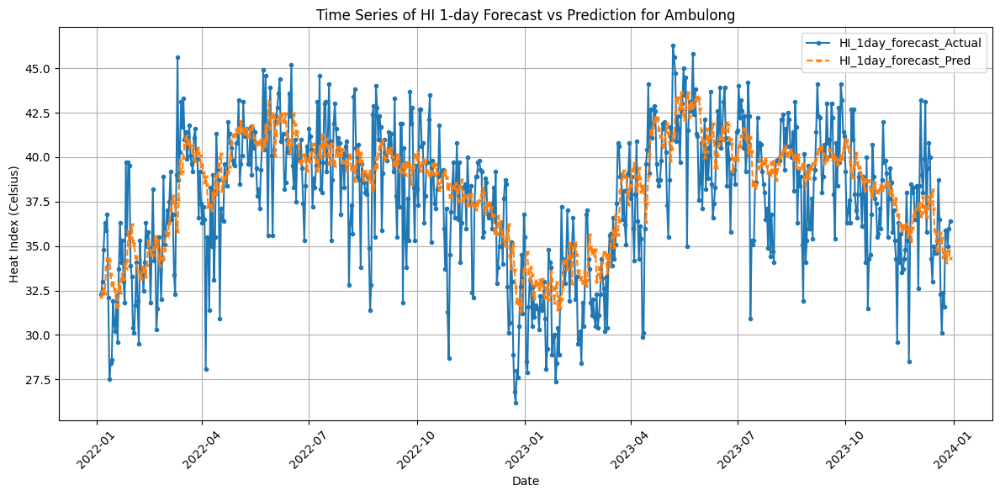

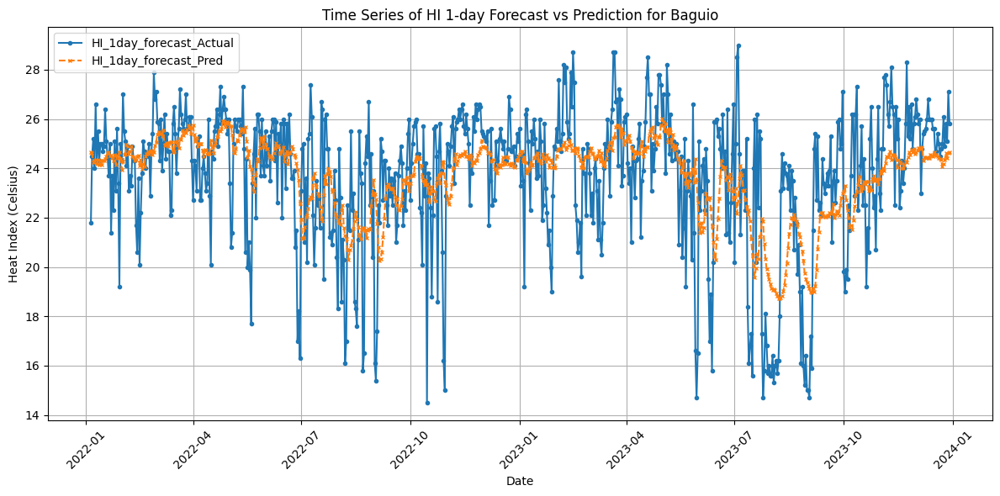

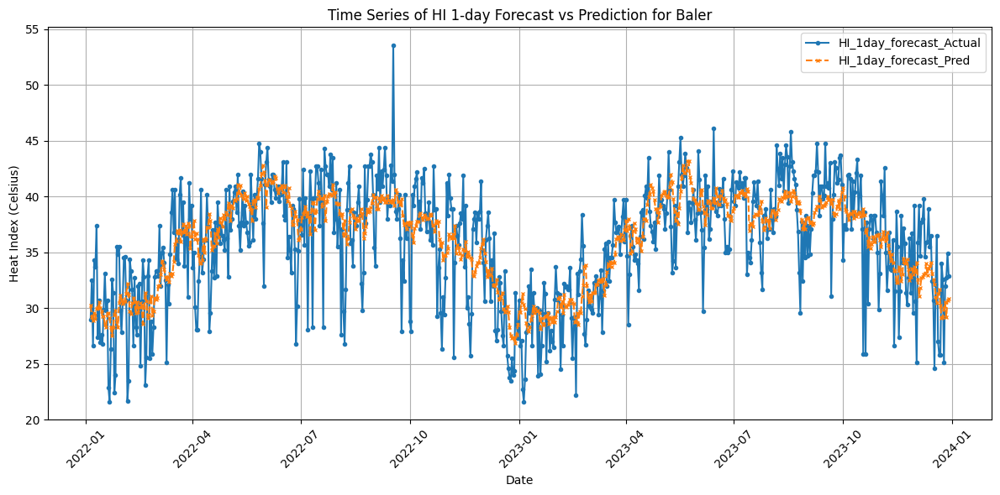

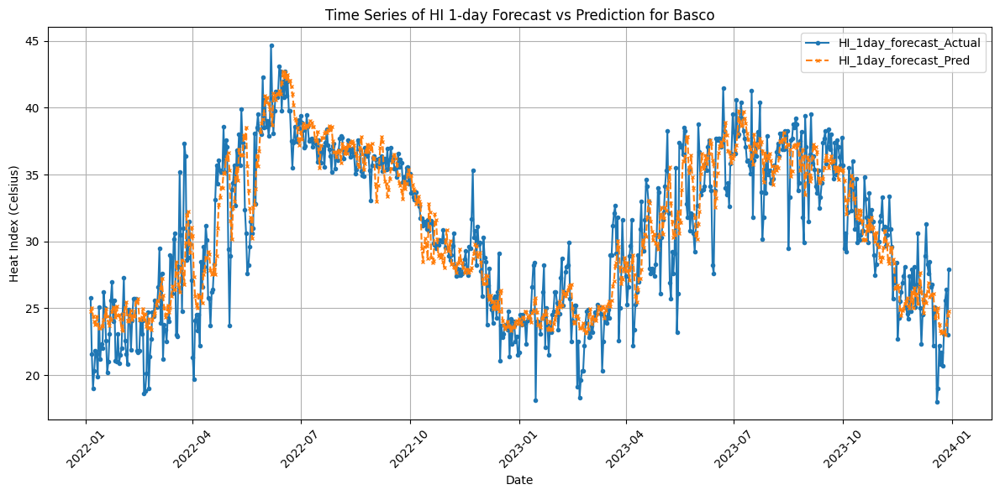

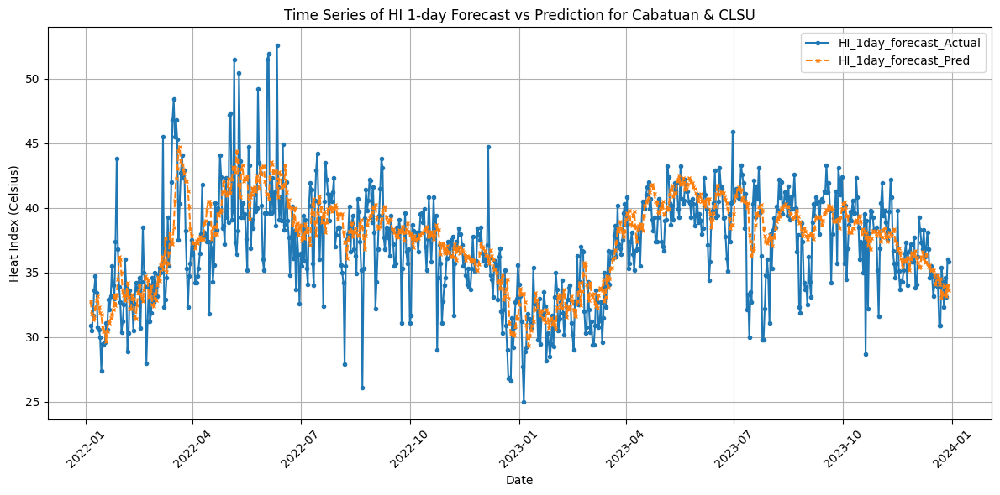

...

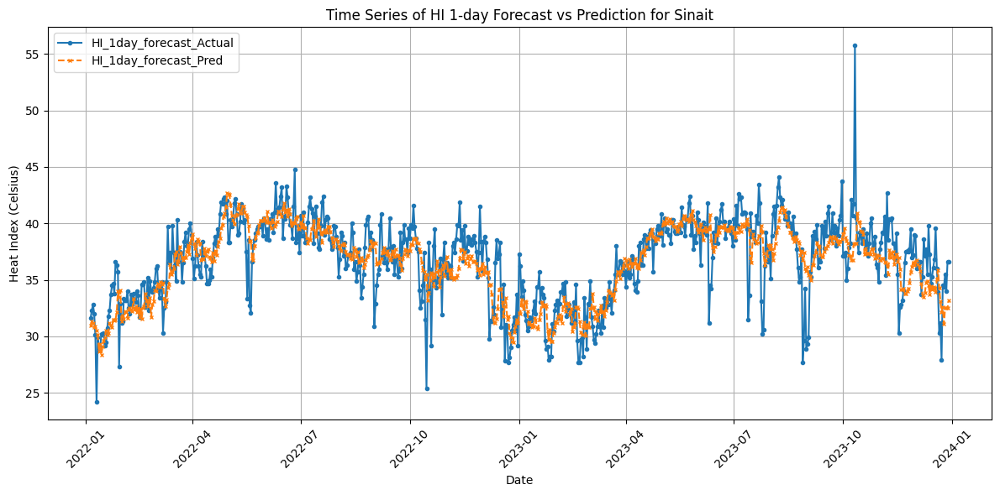

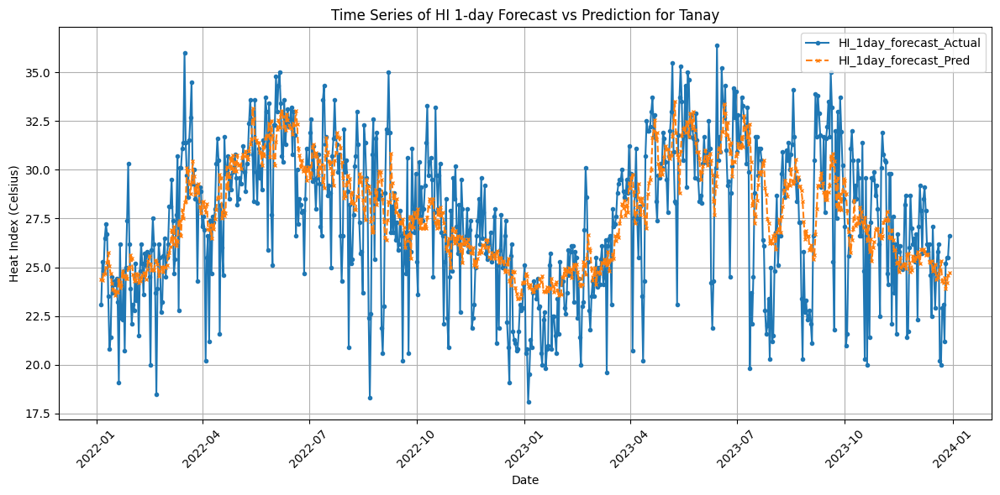

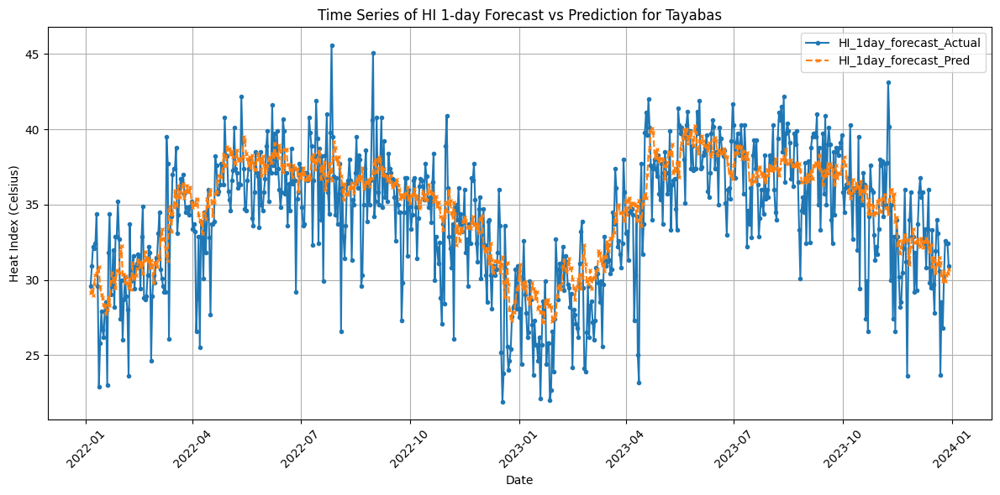

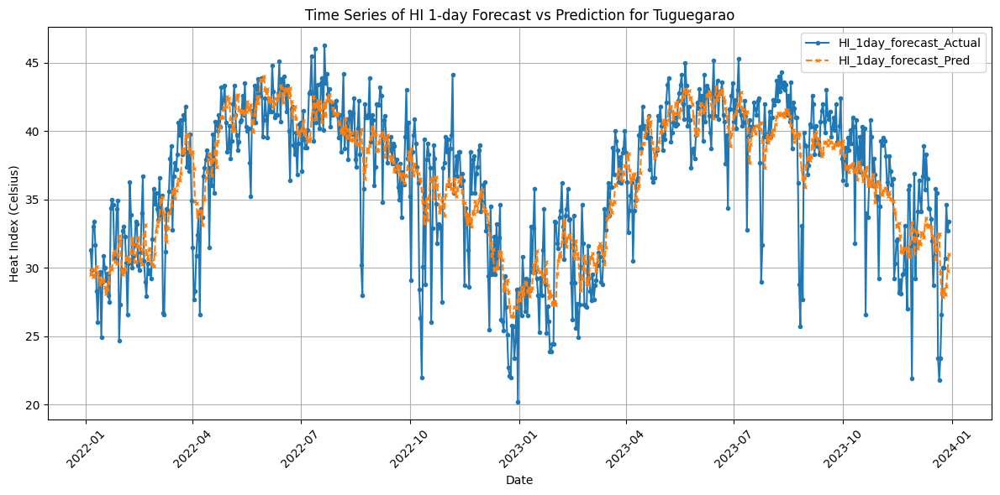

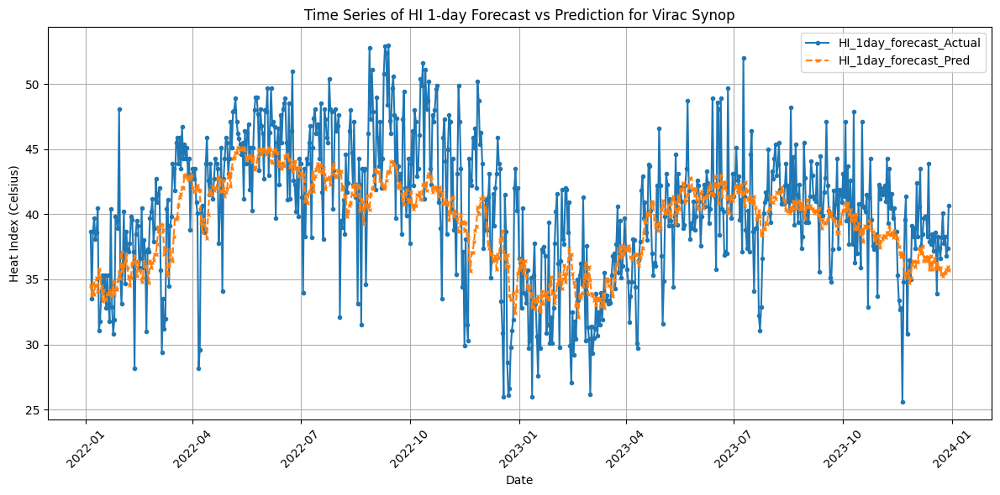

In [ ]:
# Plot HI_1day_forecast and HI_1day_forecast_Pred for each station in df_results_by_station
for station in stations:
    station_df = df_results_by_station[df_results_by_station['Station'] == station]
    plt.figure(figsize=(12, 6))
    plt.plot(station_df['Date'], station_df['HI_1day_forecast_Actual'], marker='o', linestyle='-', markersize=3, label='HI_1day_forecast_Actual')
    plt.plot(station_df['Date'], station_df['HI_1day_forecast_Pred'], marker='x', linestyle='--', markersize=3, label='HI_1day_forecast_Pred')
    plt.title(f'Time Series of HI 1-day Forecast vs Prediction for {station}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

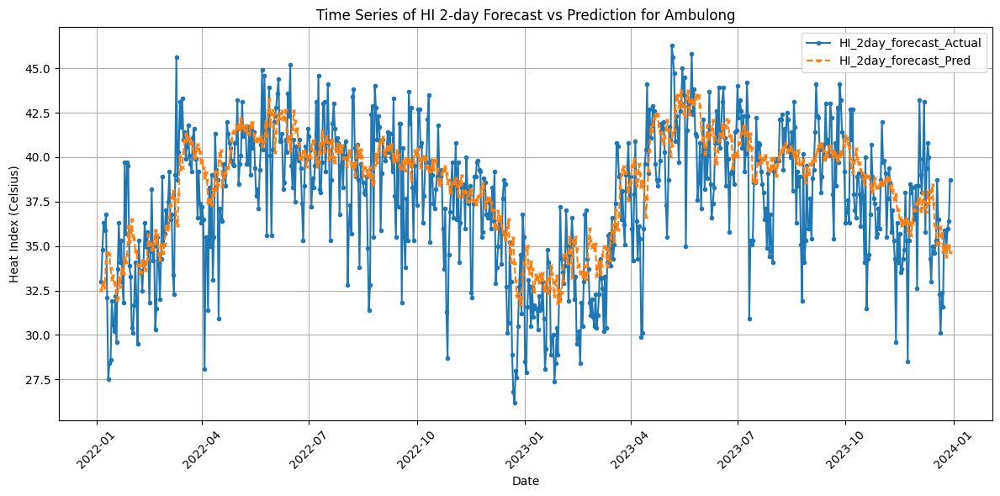

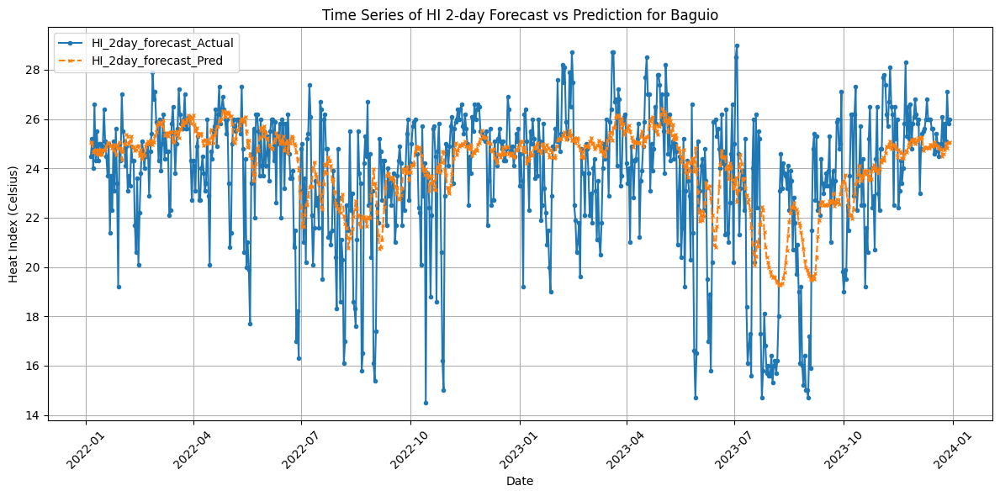

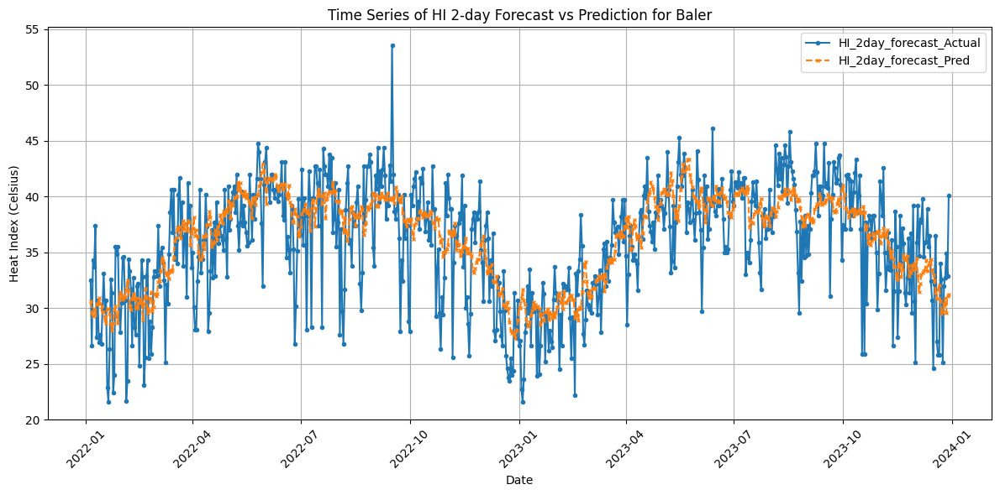

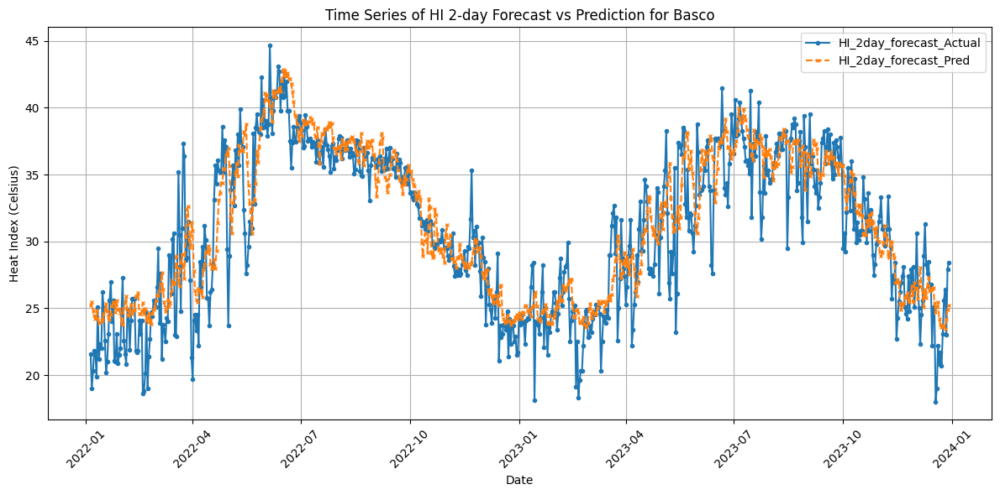

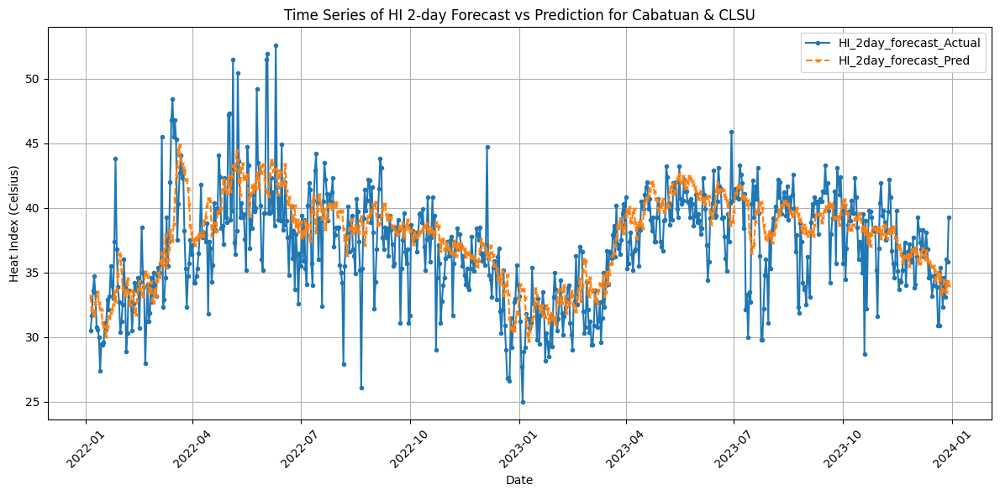

...

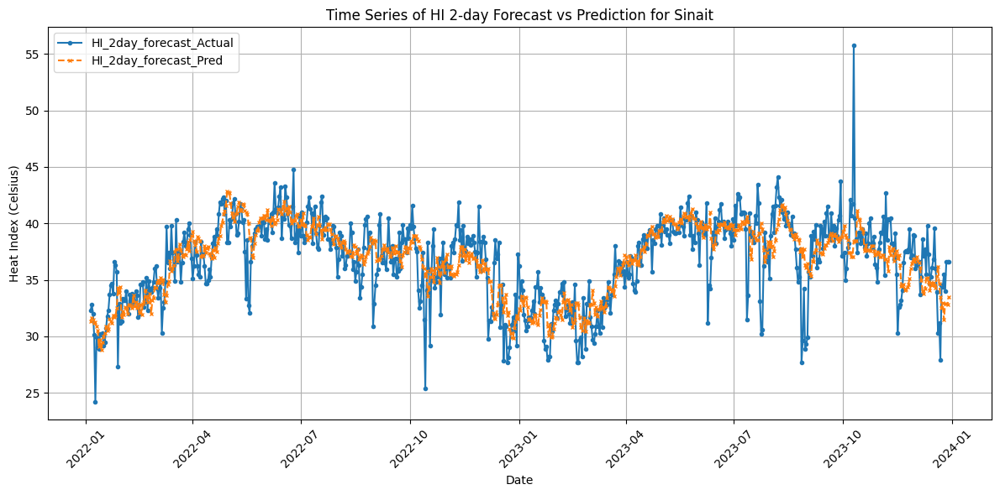

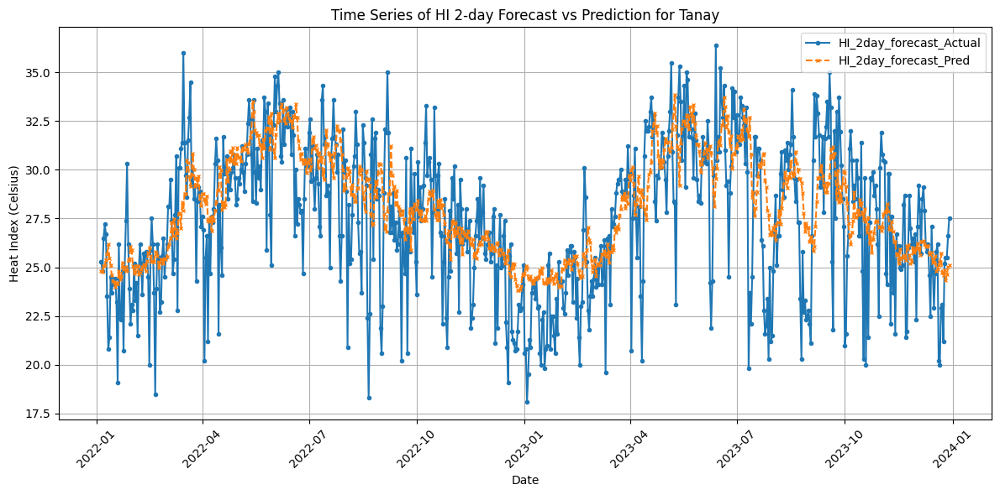

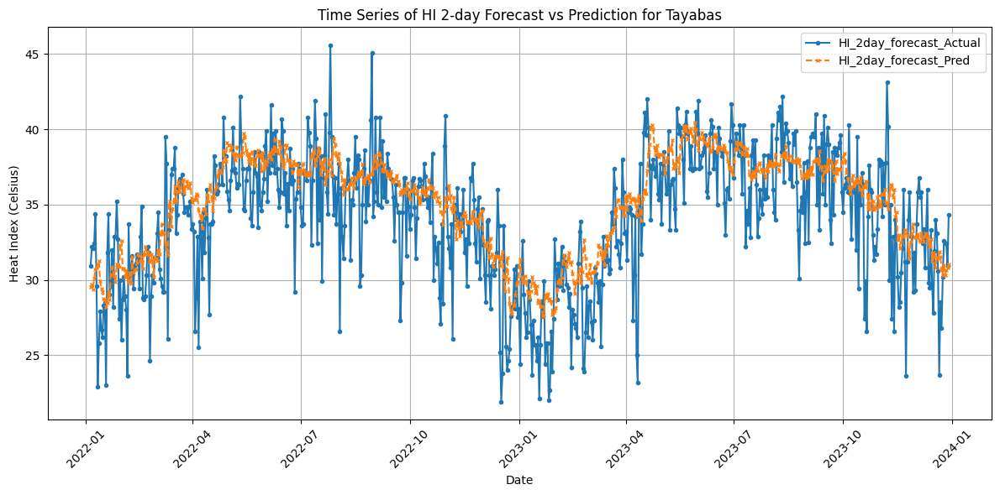

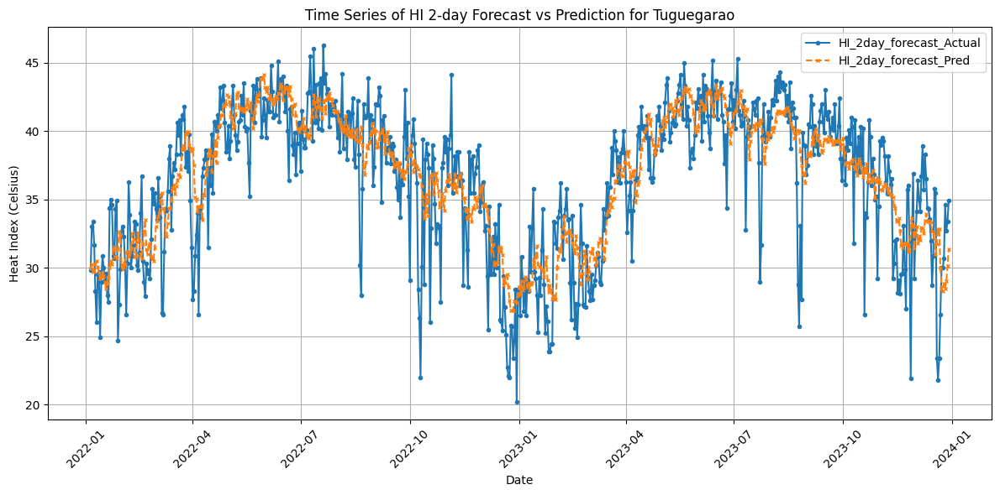

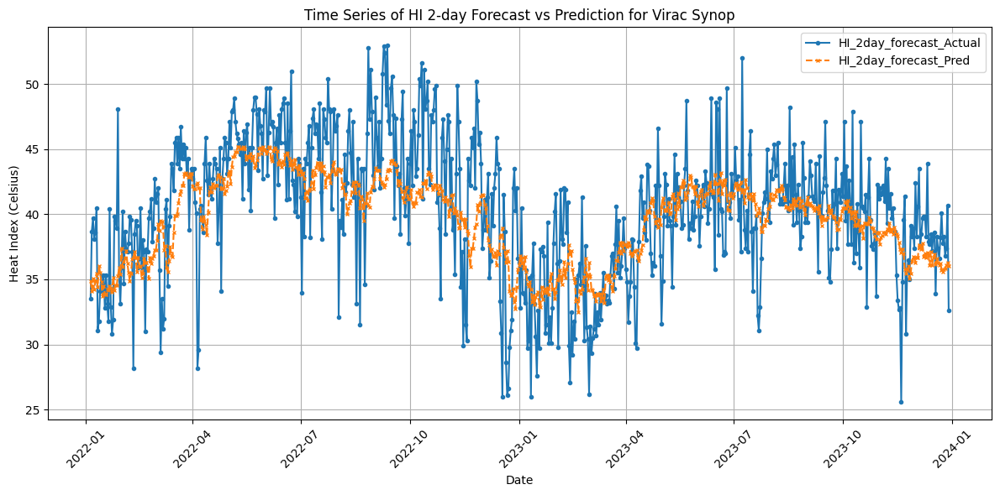

In [ ]:
# Plot HI_2day_forecast and HI_2day_forecast_Pred for each station in df_results_by_station
for station in stations:
    station_df = df_results_by_station[df_results_by_station['Station'] == station]
    plt.figure(figsize=(12, 6))
    plt.plot(station_df['Date'], station_df['HI_2day_forecast_Actual'], marker='o', linestyle='-', markersize=3, label='HI_2day_forecast_Actual')
    plt.plot(station_df['Date'], station_df['HI_2day_forecast_Pred'], marker='x', linestyle='--', markersize=3, label='HI_2day_forecast_Pred')
    plt.title(f'Time Series of HI 2-day Forecast vs Prediction for {station}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()